### ICE Deterioration

##### input: 1D datasets from ear5-land

_i means interpolated data
    
- u_10 units :m s**-1 long_name : 10 metre U wind component
- v_10 units :m s**-1 long_name : 10 metre V wind component
- t2m units :K long_name : 2 metre temperature
- d2m units :K long_name : 2 metre dew temperature
- skt units :K long_name : ski temperature
- tp_i units :m/hour long_name : total precipitation per hour
- sp units :Pa long_name: surface pressure
- slhf units :J m**-2 long_name : surface_upward_latent_heat_flux
- sshf units :J m**-2 long_name : surface sensible heat flux
- ssrd units :J m**-2 long_name : Surface solar radiation downwards
- strd units :J m**-2 long_name : Surface thermal radiation downwards
    - slhf_i units :W m**-2
    - sshf_i units :W m**-2
    - ssrd_i units :W m**-2
    - strd_i units :W m**-2


In [16]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker


In [2]:
import pandas
import numpy as np
df_1959 = pandas.read_csv('1d_1959.csv')
df_2020 = pandas.read_csv('1d_2020.csv')
df_2021 = pandas.read_csv('1d_2021.csv')

# settings
albedo = 0.5
rho_water = 1000  # Kg/m3  water
rho_ice = 917 # Kg/m3
sigma = 5.67e-8; #Stefan-Boltzmann constant [J/m2 K4]  in second w/s!
cp_air = 1005  # heat capacity of air   J/(kg*K)  in 300K
cp_ice = 2108 # J/(kgK)
lf = 334000 #Latent heat of fusion L f = 334 000 J/kg -1 (phase change ice – water)
wvtc = 1.5e-03 # Water vapour transfer coefficient


In [511]:
# example of A: turbulance coefficient
d = 0.5
z_0 = 0.05
np.log((2-d)/z_0)/np.log((10-d)/z_0)

0.6482145564584187

In [3]:
def extent_df(df_1):
    #a. calculate wind_2m + truck speed
    #b. calculate vapor pressure
    
    for index,row in df_1.iterrows():  # iteration hour by hour

        # a. calculate u_2 v_2 by u_10, v_10
        # Zero-plane displacement ({\displaystyle d}d) is the height in meters above the ground 
        # at which zero wind speed is achieved as a result of flow obstacles such as trees or buildings. 
        # It can be approximated as 2/3 to 3/4 of the average height of the obstacles.
        df_1.loc[index,'wind_0'] = np.sqrt(df_1.loc[index,'u10_i']**2 + df_1.loc[index,'v10_i']**2) * 0.648

        if index < 149: # in eu
            d = 0.5 # assume vegetation height 1-1.5
            z_0 = 0.05
            df_1.loc[index,'v_2'] = df_1.loc[index,'v10_i']*np.log((2-d)/z_0)/np.log((10-d)/z_0) - 26.4*0.2778
            df_1.loc[index,'u_2'] = df_1.loc[index,'u10_i']*np.log((2-d)/z_0)/np.log((10-d)/z_0)
        elif index > 216: # in africa
            d = 0.2 # without much vegetation
            z_0 = 0.05
            df_1.loc[index,'v_2'] = df_1.loc[index,'v10_i']*np.log((2-d)/z_0)/np.log((10-d)/z_0) - 10.2*0.2778
            df_1.loc[index,'u_2'] = df_1.loc[index,'u10_i']*np.log((2-d)/z_0)/np.log((10-d)/z_0)
        else:   # in sea, back deck, no cover
            d = 0.5  # assume wave height 1.5
            z_0 = 0.0002 # smooth
            df_1.loc[index,'v_2'] = df_1.loc[index,'v10_i']*np.log((2-d)/z_0)/np.log((10-d)/z_0) - 11.0*0.2778
            df_1.loc[index,'u_2'] = df_1.loc[index,'u10_i']*np.log((2-d)/z_0)/np.log((10-d)/z_0)

        df_1.loc[index,'wind_2'] = np.sqrt(df_1.loc[index,'u_2']**2 + df_1.loc[index,'v_2']**2)

        # b. calculate specific vapor pressure es, and vapor pressure ea by dew temperature d2m
        # where  T  is in  ∘ C and  e∗  in Pa
        df_1.loc[index,'e_ice'] = 1000*0.611 * np.exp(17.27*(0) /((0)+237.3))   # specific e surface
        df_1.loc[index,'e_skin'] = 1000*0.611 * np.exp(17.27*(df_1.loc[index,'skt_i']-273.15) /((df_1.loc[index,'skt_i']-273.15)+237.3))   # surface e
        df_1.loc[index,'es_2m'] = 1000*0.611 * np.exp(17.27*(df_1.loc[index,'t2m_i']-273.15) /((df_1.loc[index,'t2m_i']-273.15)+237.3))   #  specific e 2m
        df_1.loc[index,'ea_2m'] = 1000*0.611 * np.exp(17.27*(df_1.loc[index,'d2m_i']-273.15) /((df_1.loc[index,'d2m_i']-273.15)+237.3))  # e air
    return df_1

def q_latent(air_pressure,air_temp_K,wind_2,es,ea): # downward positive, thus (es - ea) with minus in equation

    # calculate latent heat # ASSUME: water is always available! satuation = 1
    # input:
    # - es, ea, air_pressure  in Pa
    # - air_temp_K in K
    # - wind_2 in m/s
    # output:
    # - q_lat in W/m-2
    
    rho_air = air_pressure/(287.058*air_temp_K)  # air density [kg /m^3], T in K
    lv = (2500.8-2.36*(air_temp_K-273.15))*1000; #latent heat of evaporation of water [J/kg], T in C
    A = 0.4*0.4 / np.log(2/1e-2) / np.log(2/1e-2) # k = 0.4
    
    q_lat = -0.622*rho_air*lv*A*wind_2*(es-ea)/air_pressure; # potential evaporation ASSUME: water is available

    return q_lat
    
    
def q_sensi(air_pressure,air_temp_K,wind_2,ta,ts): # downward positive
    # calculate sensible heat 
    # input:
    # - ta, ts in same unit, K or T
    # - air_temp_K in K
    # - wind_2 in m/s
    # output:
    # - q_sen in W/m-2
    cp_air = 1005  # heat capacity of air   J/(kg*K)

    rho_air = air_pressure/(287.058*air_temp_K)  # air density [kg /m^3], T in K
    lv = (2500.8-2.36*(air_temp_K-273.15))*1000; #latent heat of evaporation of water [J/kg], T in C
    A = 0.4*0.4 / np.log(2/1e-2) / np.log(2/1e-2) # k = 0.4
    
    q_sen = cp_air*rho_air*A*wind_2*(ta-ts)
    return q_sen    

In [4]:
df_1959_ = extent_df(df_1959).copy()
df_2020_ = extent_df(df_2020).copy()
df_2021_ = extent_df(df_2021).copy()

## step 1: Ice on surface(temp = 0) without cover

In [6]:
def senario_ice_without_cover(df):
    # setting
    albedo = 0.5
    emissivity = 0.97
    initial_temp = -6  # in C
    energy_per_m3 = (lf+cp_ice*(0-initial_temp))*rho_ice # J/m3  initial cold content + phase change ice – water)
    df['Time'] = pandas.to_datetime(df['Time']) 
    
    for index,row in df.iterrows():  # iteration hour by hour

        # 1. calculate net solar radiation and long radiation  # 273.15 or df.loc[index,'skt_i'] for longwave

        df.loc[index,'SW_net'] = df.loc[index,'ssrd_i']*( 1 - albedo) # net short wave riadiaon
        df.loc[index,'LW_net'] = emissivity * (df.loc[index,'strd_i'] - sigma * (273.15)**4)  # net longwave = in - out - reflection # T in Kelvin

        # 2. calculate sensible heat and latent heat(water is alway available)

        df.loc[index,'q_lat'] =q_latent(df.loc[index,'sp_i'],df.loc[index,'t2m_i'],df.loc[index,'wind_2'],df.loc[index,'e_ice'],df.loc[index,'ea_2m'])
        df.loc[index,'q_sens']=q_sensi(df.loc[index,'sp_i'],df.loc[index,'t2m_i'],df.loc[index,'wind_2'],df.loc[index,'t2m_i'],273.15)

        # 3. melt energy
        df.loc[index,'down_energy'] = df.loc[index,'SW_net'] + df.loc[index,'LW_net']  + df.loc[index,'q_lat'] + df.loc[index,'q_sens']  #w/m2

        # melt rate in mm/h
        df.loc[index,'meltmmh'] = df.loc[index,'down_energy']*3600 /energy_per_m3   # conversion m/s to m/h 
    return df

def weather_plot(df):
    
    plt.figure()
    ax = df.plot(x='Time',y=['t2m_i','skt_i','d2m_i'],label=['Air_2m','Skin','Dew_Temp'],ylim=(260,330),figsize=(17, 5))
    df.plot(x='Time',y='tp',secondary_y=True, label='Precipitation_Day',ax=ax)
    ax.right_ax.set_ylim(-0.0,0.045)
    ax.set_ylabel('Temperature[K]')
    ax.right_ax.set_ylabel('Precipiration[m]')
    textstr = '\n'.join((
        r'$mean\_air_t = %.1f$' % df['t2m_i'].mean(),
        r'$mean\_skin_t= %.1f$' % df['skt_i'].mean()
    ))
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    ax.text(0.01, 0.95, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', bbox=props)
    
    plt.figure()
    ax_2 = df.plot(x='Time',y=['slhf_i','sshf_i','ssrd_i','strd_i'],label=['Latent heat','Sensible heat','Solar Radiation','Longwave Radiation'],
                  figsize=(17, 5),ylim=(-700,1100))
    
    df.plot(x='Time',y='wind_0',secondary_y=True, label='Wind_2m',ax=ax_2)
    df.plot(x='Time',y='wind_2',secondary_y=True, label='Wind_truck',ax=ax_2)

    ax_2.right_ax.set_ylim(-1,40)
    ax_2.set_ylabel('Flux[W/m2]')
    ax_2.right_ax.set_ylabel('Windspeed[m/s]')
    
def melt_plot(df,y_lim=[-1,7]):
    # df must be standard output format by model.
    
    #1 y1:   y2: melt mmh cumsum plot
    df['Time'] = pandas.to_datetime(df['Time'])

    sw = df['SW_net'].cumsum()*3600 /334000 /rho_ice
    q_la = df['q_lat'].cumsum()*3600 /334000 /rho_ice
    q_se = df['q_sens'].cumsum()*3600 /334000 /rho_ice
    lw = df['LW_net'].cumsum()*3600 /334000 /rho_ice

    total = sw.iloc[-1]+q_la.iloc[-1]+q_se.iloc[-1]+lw.iloc[-1]
    
    accumulation_from_flux = {
    'Solar Radiation': sw,
    'Latent heat': q_la,
    'Sensible heat': q_se,
    'Longwave Radiation': lw,
    }
    
    fig = plt.figure(figsize=(8, 6))
    ax = fig.add_axes((0.1,0.5,0.8,0.6))
    ax.stackplot(df['Time'], accumulation_from_flux.values(),labels=accumulation_from_flux.keys(),colors=['tab:green','tab:blue','tab:orange','tab:red'], alpha=0.8)
    ax.legend(loc='upper left')
    ax.set_title('Down Energy Contributions')
    ax.set_ylabel('Equivalent melt depth [m]')
    plt.xlim([df['Time'].min(), df['Time'].max()])
    plt.ylim(y_lim[0], y_lim[1])

    plt.xticks(rotation=50)
    
    
    textstr = '\n'.join((
        r'Solar Radiation ={:.1f}%'.format(sw.iloc[-1]/total*100),
        r'Latent heat = {:.1f}%'.format(q_la.iloc[-1]/total*100),
        r'Sensible heat = {:.1f}%'.format(q_se.iloc[-1]/total*100),
        r'Longwave Radiation = {:.1f}%'.format(lw.iloc[-1]/total*100)
    ))
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    ax.text(0.01, 0.45, textstr, transform=ax.transAxes, fontsize=10,
        verticalalignment='top', bbox=props)
         
    
    fig = plt.figure()
    ax_3 = df.plot(x='Time',y='meltmmh',legend=False,figsize=(12.35, 6))
    
    df.plot.bar(x='Time',y=['SW_net','q_lat','q_sens','LW_net'],label=['Solar Radiation','Latent heat','Sensible heat','Longwave Radiation']
                ,color=['tab:green','tab:blue','tab:orange','tab:red'],secondary_y=True,stacked=True,ax=ax_3)
    
    ticklabels = ['']*len(df['Time'])
    # Every 4th ticklable shows the month and day
    ticklabels[::120] = [item.strftime('%b %d') for item in df['Time'][::120]]
    # Every 12th ticklabel includes the year
    ticklabels[::360] = [item.strftime('%b %d\n%Y') for item in df['Time'][::360]]

    ax_3.xaxis.set_major_formatter(ticker.FixedFormatter(ticklabels))

    ax_3.set_ylabel('Rate[m/hour]')
    ax_3.right_ax.set_ylabel('Melt Energy flux[W/m2]')

def senario_2_ice(df,first_layer):
    # df is dataframe
    # box, insulation are dic
    
    # 3) setting of ice
    lf = 334000 #Latent heat of fusion L f = 334 000 J/kg -1 (phase change ice – water)
    cp_ice = 2108 # J/(kgK)
    rho_ice = 917 # Kg/m3
    first_layer = first_layer #m

    initial_temp_ice = 273.15 - 6
    energy_per_m2_K = first_layer*cp_ice*rho_ice
    energy_per_m3 = (lf+cp_ice*(273.15-initial_temp_ice))*rho_ice # J/m3  initial cold content + phase change ice – water) per cubic meter
    emissivity = 0.97
    albedo = 0.5

    # 1. part 1: not related to temp.
    df['SW_net'] = df['ssrd_i']*( 1 - albedo) # net short wave riadiaon
    
    # 2. calculate related to temp
    # Latent heat method3: just use df['slhf_i']: assume the amount of evaporation is the same with bare soil
    for index,row in df.iterrows():  # iteration hour by hour
        if index == 0:
            df.loc[index,'box_t'] = initial_temp_ice
        elif index == len(df)-1:
            print('End t of box:',df.loc[index,'box_t'])
            print('Mass loss of ice:',df['ice_melt_mass_hour'].cumsum()[-2:-1])
            
        rho_air = row['sp_i']/(287.058*row['t2m_i'])  # air density [kg /m^3], T in K
        lv = (2500.8-2.36*(row['t2m_i']-273.15))*1000; #latent heat of evaporation of water [J/kg], T in C
        A = 0.4*0.4 / np.log(2/1e-2) / np.log(2/1e-2) # k = 0.4

        # 2.1 loop in second for temprature

        for i in range(0,3600):
            if i == 0:
                _temp = df.loc[index,'box_t']
                acc_lw_net = 0
                acc_q_sens = 0
                acc_q_lat = 0
                acc_q_ht = 0
            else:
                pass
            _lw_net = emissivity * (df.loc[index,'strd_i'] - sigma * (_temp)**4)
            _q_sens = q_sensi(df.loc[index,'sp_i'],df.loc[index,'t2m_i'],df.loc[index,'wind_2'],df.loc[index,'t2m_i'],_temp)
            #_q_lat = _q_sens / df.loc[index,'bowen_ratio']
            es = 1000*0.611 * np.exp(17.27*(_temp-273.15) /((_temp-273.15)+237.3))  # e_ice from temp
            _q_lat = -0.622*rho_air*lv*A*row['wind_2']*(es-row['ea_2m'])/row['sp_i']   # deficit e_ice - e_actual

            _q_heat_transffer = (_temp-273.15)*2.3/first_layer # w/m2  assumption 1: ICE = 0 degree, 3:no heat capacity of glass wool
            _down_energy_per_m2 = df.loc[index,'SW_net'] + _lw_net  + _q_lat + _q_sens - _q_heat_transffer # W/m2      size of box 
            _increment_temp = _down_energy_per_m2 / (energy_per_m2_K)
            _temp = _temp + _increment_temp
            acc_lw_net = acc_lw_net + _lw_net
            acc_q_sens = acc_q_sens + _q_sens
            acc_q_lat = acc_q_lat + _q_lat
            acc_q_ht = acc_q_ht + _q_heat_transffer

            if i == 3599:
                df.loc[index,'LW_net'] = acc_lw_net/3600
                df.loc[index,'q_sens'] = acc_q_sens/3600
                df.loc[index,'q_lat'] = acc_q_lat/3600
                df.loc[index,'q_ht'] = acc_q_ht/3600  # w/m2
                df.loc[index,'ice_melt_mass_hour'] = acc_q_ht/energy_per_m3  # ice melt m/hour
                df.loc[index,'meltmmh'] = _down_energy_per_m2*3600/energy_per_m3  # ice melt m/hour
                if index == len(df)-1:
                    break
                else:
                    df.loc[index+1,'box_t'] = _temp



        # 3. down energy
        df.loc[index,'down_energy'] = df.loc[index,'SW_net'] + df.loc[index,'LW_net']  + df.loc[index,'q_lat'] + df.loc[index,'q_sens']

    return df


In [7]:
df_s1_1 = senario_ice_without_cover(df_1959_).copy()
df_s1_2 = senario_ice_without_cover(df_2020_).copy()
df_s1_3 = senario_ice_without_cover(df_2021_).copy()

### weather plot

<Figure size 432x288 with 0 Axes>

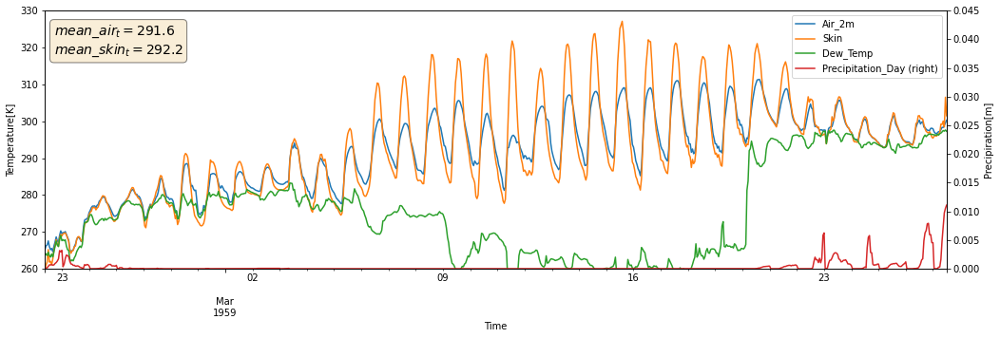

<Figure size 432x288 with 0 Axes>

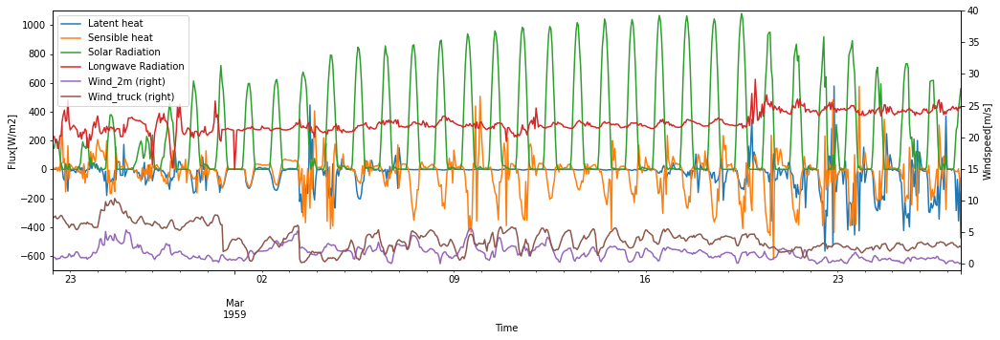

<Figure size 432x288 with 0 Axes>

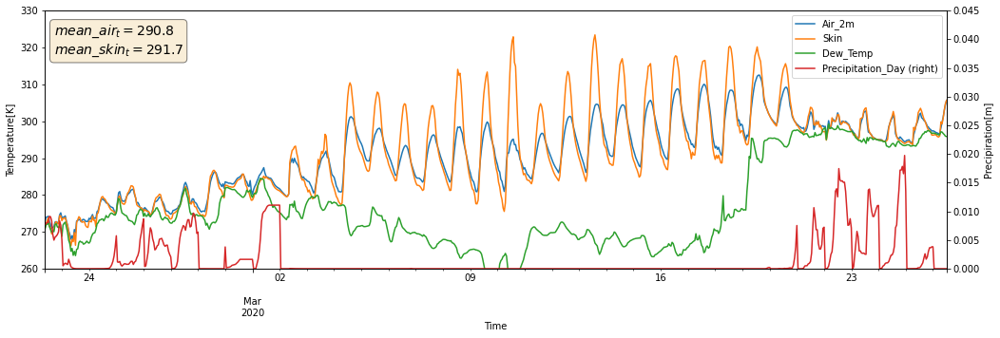

<Figure size 432x288 with 0 Axes>

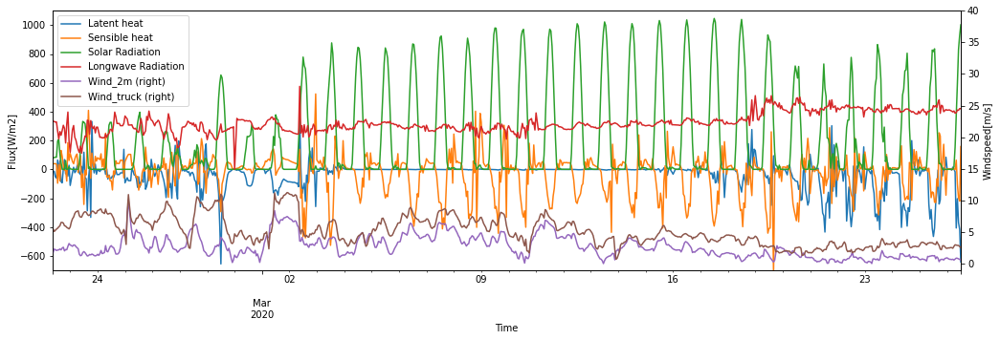

<Figure size 432x288 with 0 Axes>

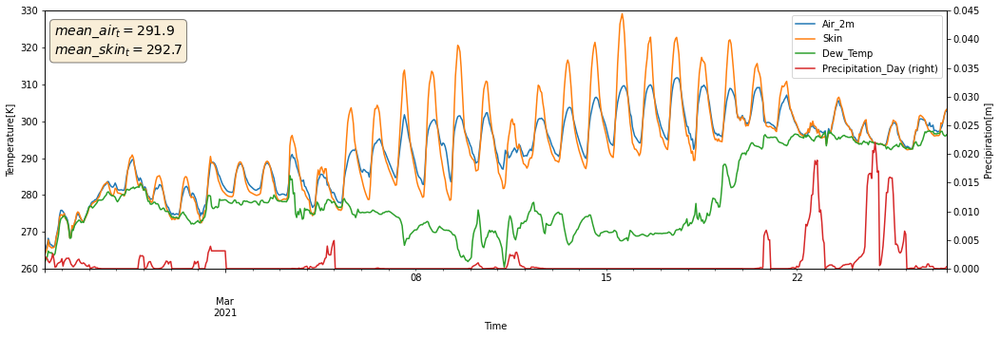

<Figure size 432x288 with 0 Axes>

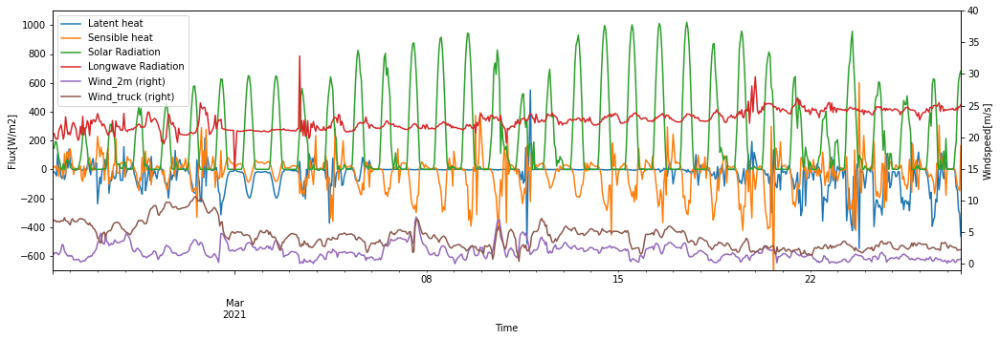

In [12]:
weather_plot(df_s1_1)
weather_plot(df_s1_2)
weather_plot(df_s1_3)

### the first scenario assuming ice temperature = 0. Is that ture? OR pick a surface layer of thickness(0.001 to 0.05) to check.(need iteration)

In [19]:
df_0001 = senario_2_ice(df_1959_,0.001).copy()
df_001 = senario_2_ice(df_1959_,0.01).copy()
df_002 = senario_2_ice(df_1959_,0.02).copy()
df_003 = senario_2_ice(df_1959_,0.03).copy()
df_005 = senario_2_ice(df_1959_,0.05).copy()

End t of box: 273.8115875458228
Mass loss of ice: 794    5.481266
Name: ice_melt_mass_hour, dtype: float64
End t of box: 278.9027103161642
Mass loss of ice: 794    4.67311
Name: ice_melt_mass_hour, dtype: float64
End t of box: 283.05621035111
Mass loss of ice: 794    3.995322
Name: ice_melt_mass_hour, dtype: float64
End t of box: 286.07081045126404
Mass loss of ice: 794    3.477343
Name: ice_melt_mass_hour, dtype: float64
End t of box: 289.9733068283376
Mass loss of ice: 794    2.747143
Name: ice_melt_mass_hour, dtype: float64


In [57]:
def compare_plot2(df_list,name_list):
    # df must be standard output format by model.
    
    def a():
        fig,ax = plt.subplots()
        ax.set_ylabel('Temperature [K]')
        for df,name in zip(df_list,name_list):
            df['Time'] = pandas.to_datetime(df['Time'])
            # temperature 
            df.plot(x='Time',y='box_t',label=name,figsize=(12, 6),ax=ax)
        
    def b():
        fig,ax_2 = plt.subplots()
        ax_2.set_ylabel('Melt rate by down energy[m]')
        for df,name in zip(df_list,name_list):
            df['meltmmh'].cumsum().plot(legend=True,label=name,figsize=(12, 6),ax=ax_2)
        #ax_2.set_xticks(df_list[0].Time)
    
    def c():
        fig,ax_3 = plt.subplots()
        ax_3.set_ylabel('Melt rate by heat transfer[m]')
        for df,name in zip(df_list,name_list):
            df['ice_melt_mass_hour'].cumsum().plot(legend=True,label=name,figsize=(12, 6),ax=ax_3)
        #ax_3.set_xticks(df_list[0].Time)
    
    a()
    b()
    c()

<AxesSubplot:xlabel='Time'>

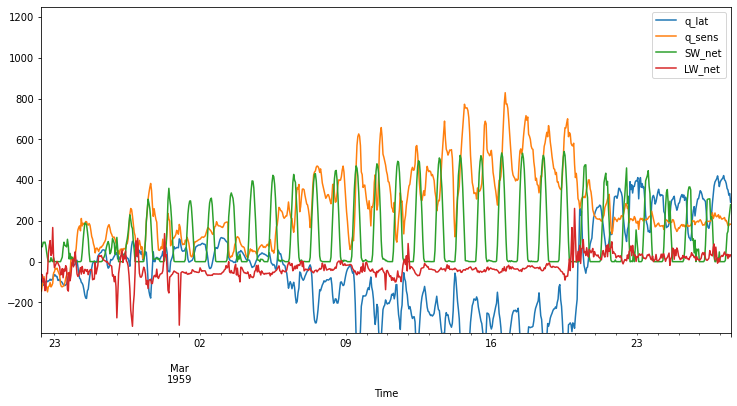

In [65]:
df_005.plot(x='Time',y=['q_lat','q_sens','SW_net','LW_net'],figsize=(12.35, 6),ylim=(-350,1250))

<AxesSubplot:xlabel='Time'>

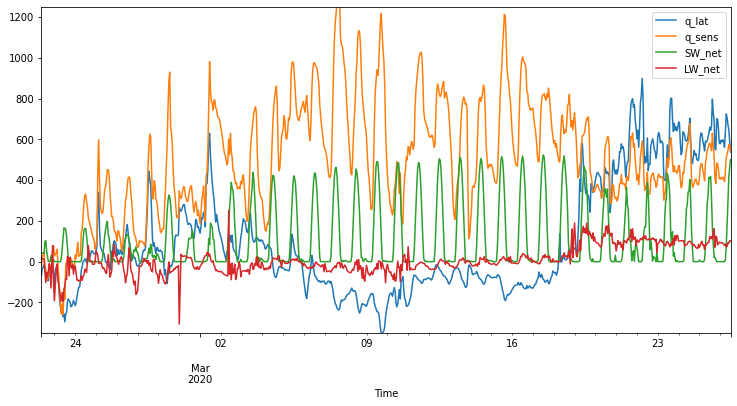

In [577]:
df_s1_2.plot(x='Time',y=['q_lat','q_sens','SW_net','LW_net'],figsize=(12.35, 6),ylim=(-350,1250))

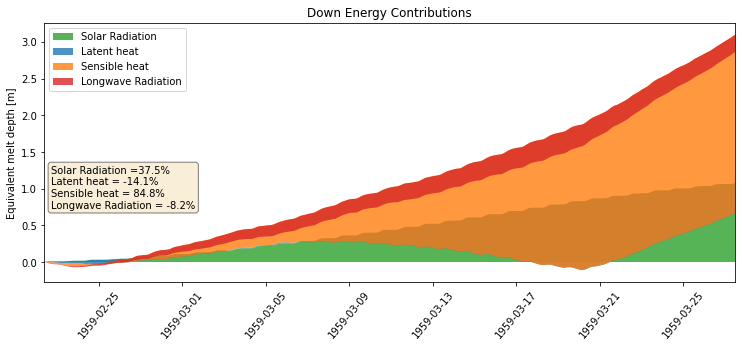

<Figure size 432x288 with 0 Axes>

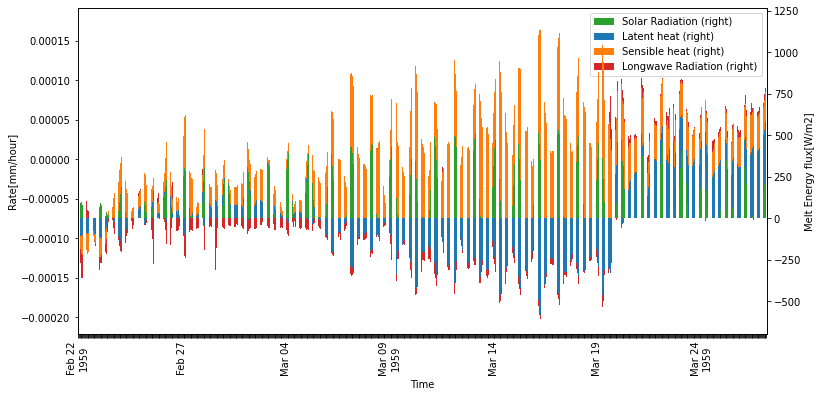

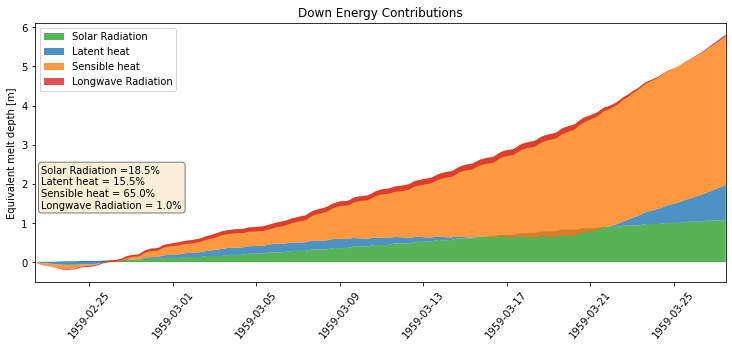

<Figure size 432x288 with 0 Axes>

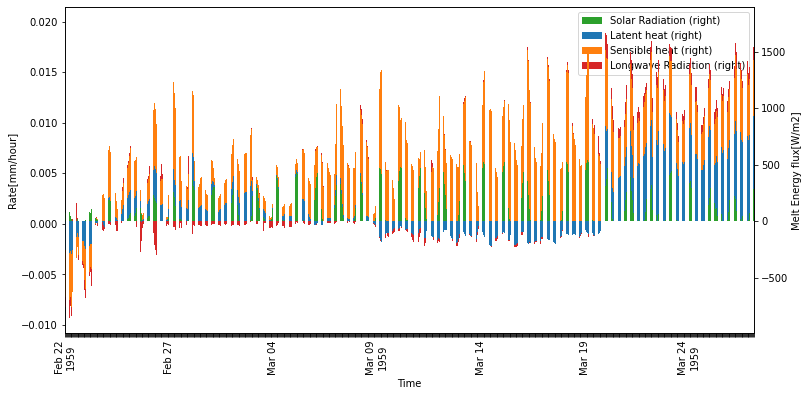

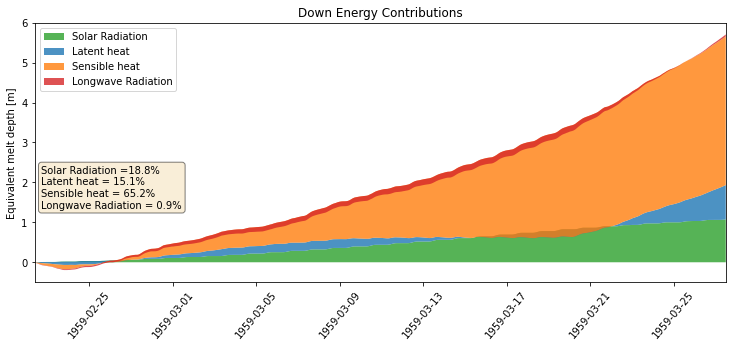

<Figure size 432x288 with 0 Axes>

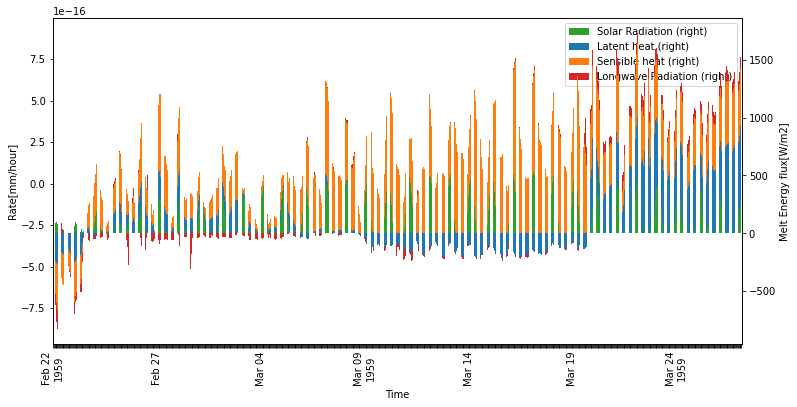

In [62]:
melt_plot(df_005)
melt_plot(df_s1_1)
melt_plot(df_0001)

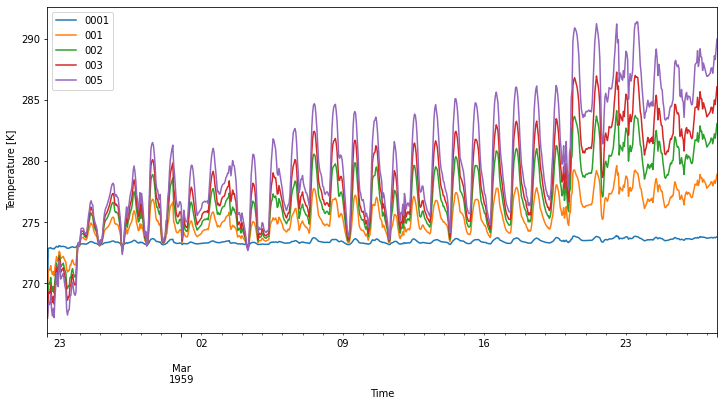

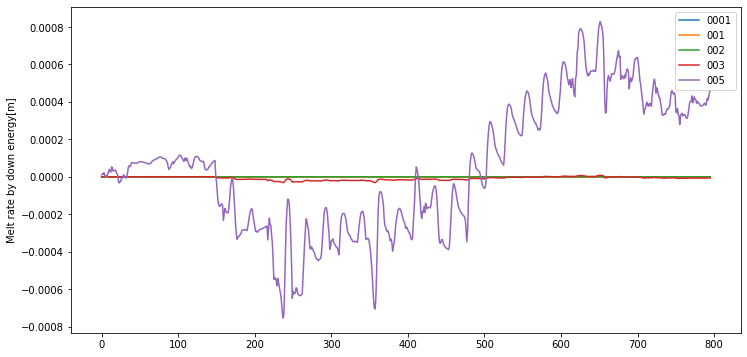

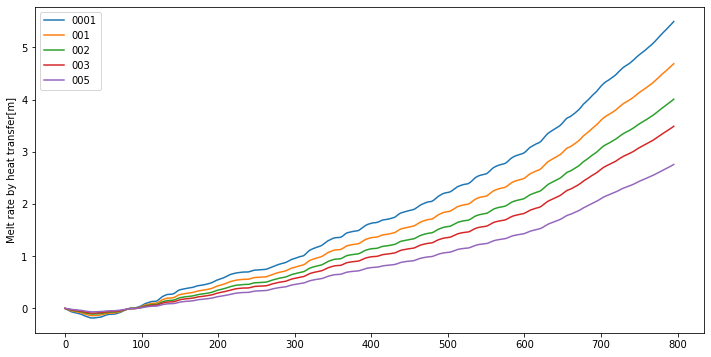

In [58]:
compare_plot2([df_0001,df_001,df_002,df_003,df_005],['0001','001','002','003','005'])

### the melt coparision

794    5.586252
Name: meltmmh, dtype: float64
794    6.504786
Name: meltmmh, dtype: float64


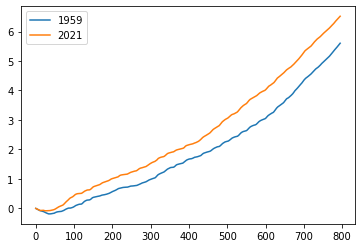

In [99]:
fig,ax = plt.subplots()
df_s1_1['meltmmh'].cumsum().plot(legend=True, label='1959',ax=ax)
#df_s1_2['meltmmh'].cumsum().plot(legend=True, label='2020')
df_s1_3['meltmmh'].cumsum().plot(legend=True, label='2021',ax=ax)
#df_0001['ice_melt_mass_hour'].cumsum().plot(legend=True, label='0001')
print(df_s1_1['meltmmh'].cumsum()[-2:-1])
print(df_s1_3['meltmmh'].cumsum()[-2:-1])

<AxesSubplot:xlabel='Time'>

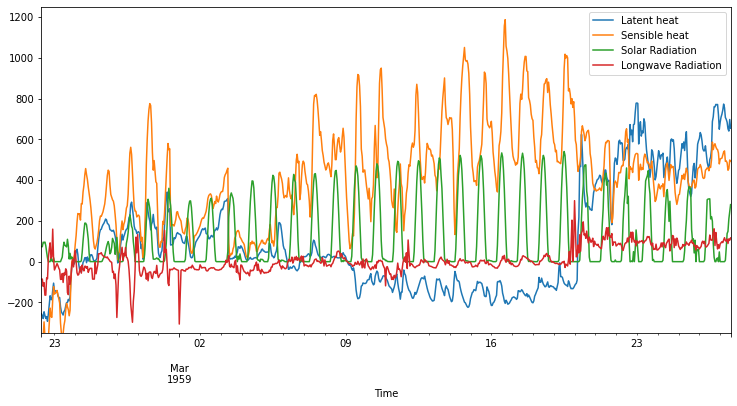

In [79]:
#df_s1_1.plot(x='Time',y=['ea_2m','e_ice','es_2m'],figsize=(12.35, 6))
df_s1_1.plot(x='Time',y=['q_lat','q_sens','SW_net','LW_net'],label=['Latent heat','Sensible heat','Solar Radiation','Longwave Radiation'],figsize=(12.35, 6),ylim=(-350,1250))

<AxesSubplot:xlabel='Time'>

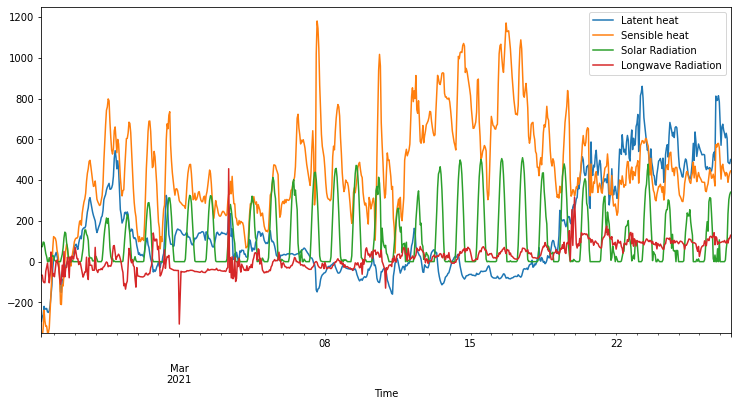

In [80]:
#df_s1_3.plot(x='Time',y=['ea_2m','e_ice','es_2m'],figsize=(12.35, 6))
df_s1_3.plot(x='Time',y=['q_lat','q_sens','SW_net','LW_net'],label=['Latent heat','Sensible heat','Solar Radiation','Longwave Radiation'],figsize=(12.35, 6),ylim=(-350,1250))

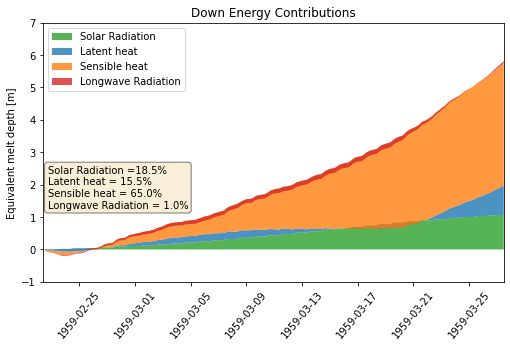

<Figure size 432x288 with 0 Axes>

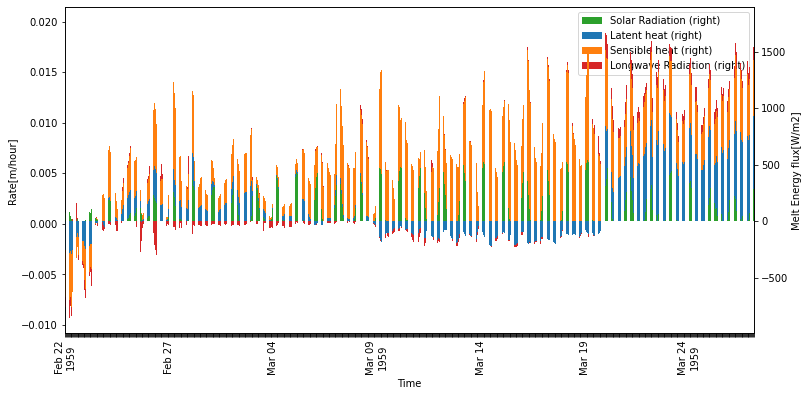

In [101]:
melt_plot(df_s1_1,y_lim=[-1,7])


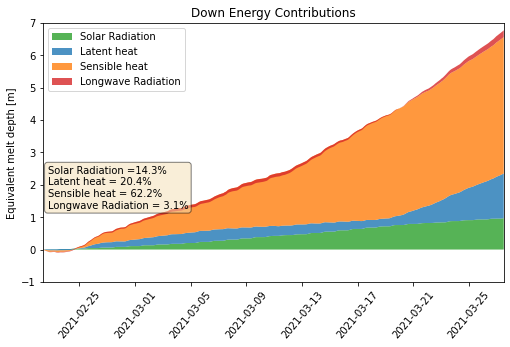

<Figure size 432x288 with 0 Axes>

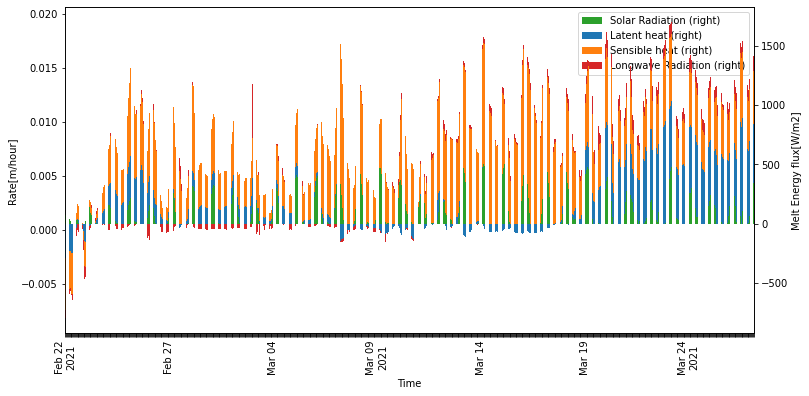

In [102]:
melt_plot(df_s1_3,y_lim=[-1,7])

In [78]:
print(df_s1_3['wind_2'].mean())
print(df_s1_1['wind_2'].mean())

4.302716800879417
3.9604672723867904


### others

<AxesSubplot:xlabel='Time'>

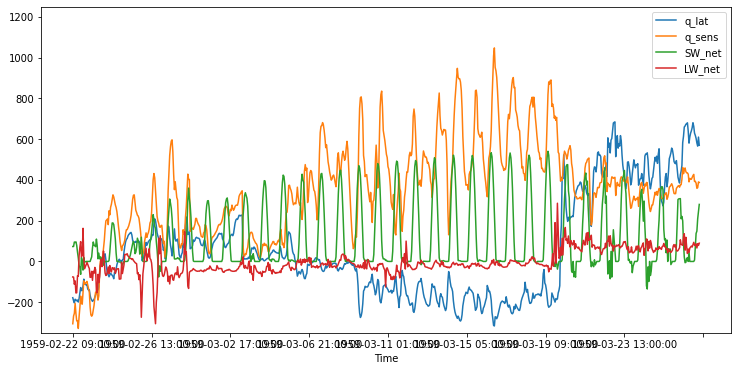

In [581]:
df_001.plot(x='Time',y=['q_lat','q_sens','SW_net','LW_net'],figsize=(12.35, 6),ylim=(-350,1250))

<AxesSubplot:xlabel='Time'>

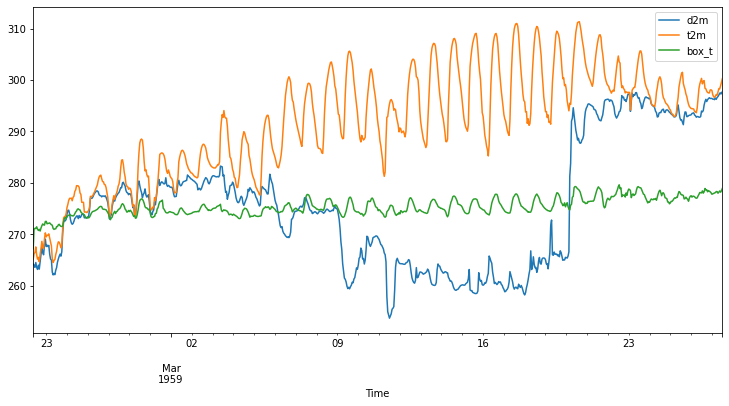

In [560]:
df.plot(x='Time',y=['d2m','t2m','box_t'],figsize=(12.35, 6),ylim=(250,320))

<AxesSubplot:xlabel='Time'>

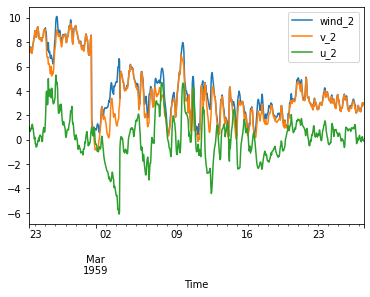

In [312]:
# compare wind speed and relative wind speed
df.plot(x='Time',y=['wind_2','v_2','u_2'])

## step 2:  box/insulation  senario

In [5]:
def senario_normal(df,box,insulation):
    # df is dataframe
    # box, insulation are dic
    
    # 1) assumption of box
    initial_temp = box['initial_temp']  # in K
    box_thicness = box['thickness'] # m
    rho_box = box['rho'] # kg/m3
    cp_box = box['cp'] # J/kgK
    k_box = box['k'] 
    albedo = box['albedo']
    emissivity = box['emissivity']
    energy_per_m2_K = box_thicness*cp_box*rho_box  # J/m2*K  energy need for change temperature of box per square meter*K 

    # 2) setting of insulation
    in_k = insulation['k'] # heat conductivity W/mK
    gw_thickness = insulation['thickness'] # m
    print('box:',box)
    print('insulation:',insulation)
    
    gw_k = 1/((gw_thickness/in_k)+(0.02-box_thicness)/k_box) # total heat resistance w/(m2k)
    
    # 3) setting of ice
    lf = 334000 #Latent heat of fusion L f = 334 000 J/kg -1 (phase change ice – water)
    cp_ice = 2108 # J/(kgK)
    rho_ice = 917 # Kg/m3
    initial_temp_ice = 273.15 - 6
    energy_per_m3 = (lf+cp_ice*(273.15-initial_temp_ice))*rho_ice # J/m3  initial cold content + phase change ice – water) per cubic meter


    # 1. part 1: not related to temp.
    df['SW_net'] = df['ssrd_i']*( 1 - albedo) # net short wave riadiaon

    # Latent heat method1: this is not working, too much outliers, because the the amount of water is fixed, biger wind just make evaporation faster but not more
    #df.loc[index,'q_lat'] = df.loc[index,'slhf_i']*df.loc[index,'wind_2']/df.loc[index,'wind_0'] # asume same saturation with soil, but wind speed different

    # Latent heat method2: BAD!
    #df['bowen_ratio'] = df['sshf_i'] / df['slhf_i'] # assume the bowen_ratio is same for soil and box

    
    # 2. calculate related to temp
    # Latent heat method3: just use df['slhf_i']: assume the amount of evaporation is the same with bare soil
    for index,row in df.iterrows():  # iteration hour by hour
        if index == 0:
            df.loc[index,'box_t'] = initial_temp
        elif index == len(df)-1:
            print('End t of box:',df.loc[index,'box_t'])
            print('Mass loss of ice:',df['ice_melt_mass_hour'].cumsum()[-2:-1])

        # 2.1 loop in second for temprature

        for i in range(0,3600):
            if i == 0:
                _temp = df.loc[index,'box_t']
                acc_lw_net = 0
                acc_q_sens = 0
                acc_q_lat = 0
                acc_q_ht = 0
            else:
                pass
            _lw_net = emissivity * (df.loc[index,'strd_i'] - sigma * (_temp)**4)
            _q_sens = q_sensi(df.loc[index,'sp_i'],df.loc[index,'t2m_i'],df.loc[index,'wind_2'],df.loc[index,'t2m_i'],_temp)
            #_q_lat = _q_sens / df.loc[index,'bowen_ratio']
            _q_lat = df.loc[index,'slhf_i']
            
            _q_heat_transffer = (_temp-273.15)*gw_k # w/m2  assumption 1: ICE = 0 degree, 3:no heat capacity of glass wool
            
            _down_energy_per_m2 = df.loc[index,'SW_net'] + _lw_net  + _q_lat + _q_sens - _q_heat_transffer # W/m2      size of box 
            _increment_temp = _down_energy_per_m2 / (energy_per_m2_K)
            _temp = _temp + _increment_temp
            acc_lw_net = acc_lw_net + _lw_net
            acc_q_sens = acc_q_sens + _q_sens
            acc_q_lat = acc_q_lat + _q_lat
            acc_q_ht = acc_q_ht + _q_heat_transffer

            if i == 3599:
                df.loc[index,'LW_net'] = acc_lw_net/3600
                df.loc[index,'q_sens'] = acc_q_sens/3600
                df.loc[index,'q_lat'] = acc_q_lat/3600
                #df.loc[index,'q_ht_s'] = _q_heat_transffer
                df.loc[index,'q_ht'] = acc_q_ht/3600  # w/m2
                df.loc[index,'ice_melt_mass_hour'] = acc_q_ht*1.49*1.49*6/energy_per_m3*rho_ice  # ice melt Kg/hour
                df.loc[index,'meltmmh'] = acc_q_ht*1.49*1.49*6/energy_per_m3/1*1000  # ice melt mm/hour
                if index == len(df)-1:
                    break
                else:
                    df.loc[index+1,'box_t'] = _temp

        # 3. down energy
        df.loc[index,'down_energy'] = df.loc[index,'SW_net'] + df.loc[index,'LW_net']  + df.loc[index,'q_lat'] + df.loc[index,'q_sens']

    return df

def compare_plot(df_list,name_list):
    # df must be standard output format by model.
    fig,ax = plt.subplots()
    ax.set_ylabel('Temperature [K]')
    for df,name in zip(df_list,name_list):
        df['Time'] = pandas.to_datetime(df['Time'])
        # temperature 
        df.plot(x='lat',y='box_t',label=name,figsize=(17, 5),ax=ax)
    #df_list[-1].plot(x='Time',y='meltmmh',legend=False,secondary_y=True,ax=ax)
    #ax.right_ax.set_ylabel('Melt Rate[mm/hour]')
    #df_list[0].plot(x='lat',y='t2m_i',label='Air_temp',ax=ax)
    ax.invert_xaxis()
    
    textstr = '\n'.join((
        r'mean_1959_t ={:.1f} K'.format(df_list[0]['box_t'].mean()),
        r'mean_2021_t={:.1f} K'.format(df_list[1]['box_t'].mean()),
        r'mean_2020_t={:.1f} K'.format(df_list[2]['box_t'].mean()),
        r'mean_1959_melt_rate={:.2f} mm/h'.format(df_list[0]['meltmmh'].mean()),
        r'mean_2021_melt_rate={:.2f} mm/h'.format(df_list[1]['meltmmh'].mean()),
        r'mean_2020_melt_rate={:.2f} mm/h'.format(df_list[2]['meltmmh'].mean())
    ))
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
    ax.text(0.01, 0.65, textstr, transform=ax.transAxes, fontsize=9,
        verticalalignment='top', bbox=props)
        
    #fig,ax_2 = plt.subplots()
    #ax_2.set_ylabel('Melt rate[mm/hour]')
    #for df,name in zip(df_list,name_list):
    #    df.plot(x='Time',y='meltmmh',label=name,figsize=(12, 6),ax=ax_2)
    #textstr = '\n'.join((
    #    r'$mean\_steel_melt_rate = %.1f$' % df_list[0]['meltmmh'].mean(),
    #    r'$mean\_aluminum_melt_rate= %.1f$' % df_list[1]['meltmmh'].mean()
    #))
    #props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    #ax.text(0.01, 0.95, textstr, transform=ax.transAxes, fontsize=14,
    #    verticalalignment='top', bbox=props)
    
    
    fig,ax_3 = plt.subplots()
    ax_3.set_ylabel('Mass loss[kg]')
    for df,name in zip(df_list,name_list):
        df['ice_melt_mass_hour'].cumsum().plot(legend=True,label=name,figsize=(12, 6),ax=ax_3)
    #df_list[-1]['meltmmh'].cumsum().plot(legend=False,secondary_y=True,ax=ax_3,color='tab:green')
    #ax_3.right_ax.set_ylabel('Equivalent melt depth[mm]')
    ax_3.set_xlabel('Hours')
    textstr = '\n'.join((
        r'melt_1959= {:.1f} Kg'.format(df_list[0]['ice_melt_mass_hour'].sum()),
        r'melt_2021= {:.1f} Kg'.format(df_list[1]['ice_melt_mass_hour'].sum()),
        r'melt_2020= {:.1f} Kg'.format(df_list[2]['ice_melt_mass_hour'].sum()),
    ))
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
    ax_3.text(0.1, 1.1, textstr, transform=ax.transAxes, fontsize=9,
        verticalalignment='top', bbox=props)

        # melt rate    
        #  melt.cumsum()
        #ax_3 = df['ice_melt_mass_hour'].cumsum().plot()
        #ax_3.set_ylabel('Mass loss[kg]')
    

In [6]:
# settings
import copy

# 1) assumption of box  setting of  galvanized steel(unpainted)
box_steel = dict()

box_steel['initial_temp'] = 273.15 - 6  # in K
box_steel['thickness'] = 0.002 # m
box_steel['rho'] = 7800 # kg/m3
box_steel['cp'] = 470 # J/kgK # https://www.matweb.com/search/datasheet_print.aspx?matguid=abbf07b7f93a4c358a0ddd194f5c18be&n=1
box_steel['k'] = 52.0 #W/m-K
box_steel['albedo'] = 0.61  # 
box_steel['emissivity'] = 0.04  #  aluminum oxidized # https://www.buildingenclosureonline.com/blogs/14-the-be-blog/post/85546-the-difference-between-reflectance-and-emittance

    # setting of aluminum #  Thermal Conductivity 237.0 W/m-K
box_al = box_steel.copy()
box_al['rho'] = 2700 # kg/m3
box_al['cp'] = 890 # J/kgK # https://gchem.cm.utexas.edu/data/section2.php?target=heat-capacities.php
box_al['emissivity'] = 0.25  #  aluminum oxidized # https://www.buildingenclosureonline.com/blogs/14-the-be-blog/post/85546-the-difference-between-reflectance-and-emittance
box_al['k'] = 237 #W/m-K

box_w = box_steel.copy()
box_w['rho'] = 270 # kg/m3
box_w['cp'] = 890 # J/kgK # 
box_w['emissivity'] = 0.9  #  
box_w['albedo'] = 0.15 
box_w['k'] = 0.11 #W/m-K

# 2) setting of glasswool
insulation_gw = dict()
insulation_gw['k'] = 0.04 # heat conductivity W/mK
insulation_gw['thickness'] = 0.25 # m

    # or clay-sawdust brick
insulation_sawdust = insulation_gw.copy()
insulation_sawdust['k'] = 0.63

    # or sawdust
insulation_sawdust_2 = insulation_gw.copy()
insulation_sawdust_2['k'] = 0.08   


In [7]:
# main

# steel vs alluminum vs wood
#df_s2_1 = senario_normal(df_1959_,box_steel,insulation_gw).copy()
df_s3_1 = senario_normal(df_1959_,box_al,insulation_gw).copy()
#df_s4_1 = senario_normal(df_1959_,box_w,insulation_gw).copy()

# glasswool vs sawdust1 and sawdust_2
#df_s5_1 = senario_normal(df_1959_,box_al,insulation_sawdust).copy()
#df_s6_1 = senario_normal(df_1959_,box_al,insulation_sawdust_2).copy()

# 1959 vs 2020
#df_s2_3 = senario_normal(df_2021_,box_steel,insulation_gw).copy()
#df_s3_2 = senario_normal(df_2020_,box_al,insulation_gw).copy()
#df_s3_3 = senario_normal(df_2021_,box_al,insulation_gw).copy()
#df_s4_3 = senario_normal(df_2021_,box_w,insulation_gw).copy()


box: {'initial_temp': 267.15, 'thickness': 0.002, 'rho': 2700, 'cp': 890, 'k': 237, 'albedo': 0.61, 'emissivity': 0.25}
insulation: {'k': 0.04, 'thickness': 0.25}
End t of box: 305.3841718781442
Mass loss of ice: 794    351.983276
Name: ice_melt_mass_hour, dtype: float64


In [208]:
df_s2_1['ice_melt_mass_hour'].sum()

372.93017830890085

### 2.1 steel vs alluminum

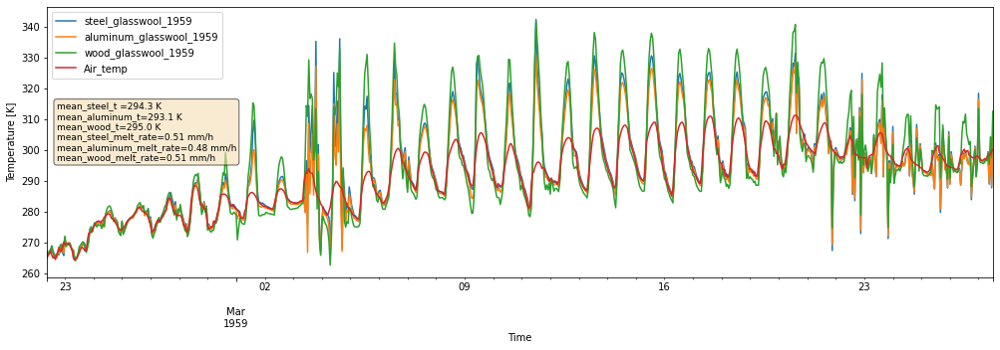

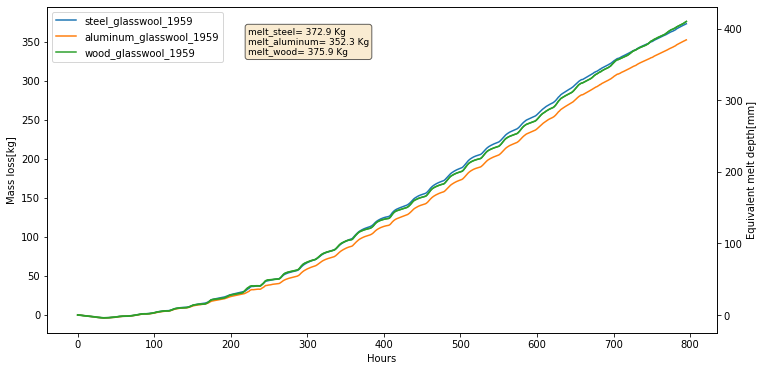

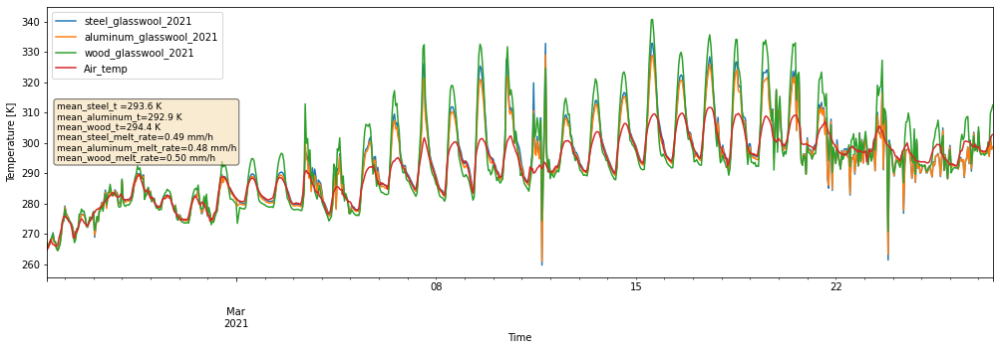

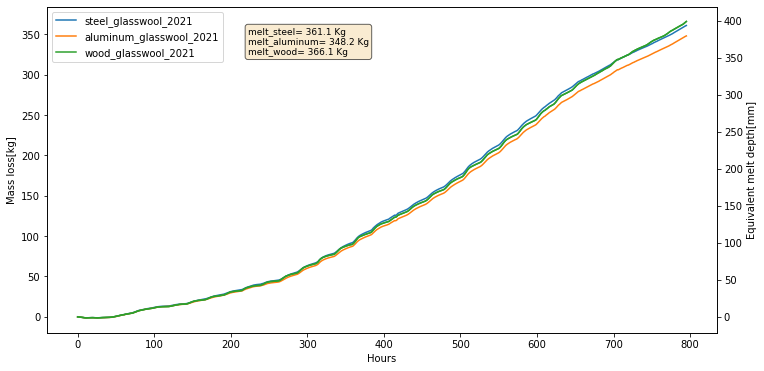

In [228]:
#compare_plot([df_s2_1,df_s3_1,df_s5_1,df_s4_1],['steel_glasswool','alluminum_glasswool','alluminum_sawdust','alluminum_sawdust_brick'])
#compare_plot([df_s2_1,df_s3_1,df_s2_3,df_s5_1],['aluminum_glasswool_1959','aluminum_glasswool_2021','aluminum_glasswool_2020'])
#compare_plot([df_s2_1,df_s3_1,df_s4_1],['steel_glasswool_1959','aluminum_glasswool_1959','wood_glasswool_1959'])
#compare_plot([df_s2_1,df_s3_1,df_s4_1,df_s2_3,df_s3_3,df_s4_3],['steel_glasswool_1959','aluminum_glasswool_1959','wood_glasswool_1959','steel_glasswool_2021','aluminum_glasswool_2021','wood_glasswool_2021'])


In [125]:
df_s2_1['meltmmh'].sum()

401.08640367692556

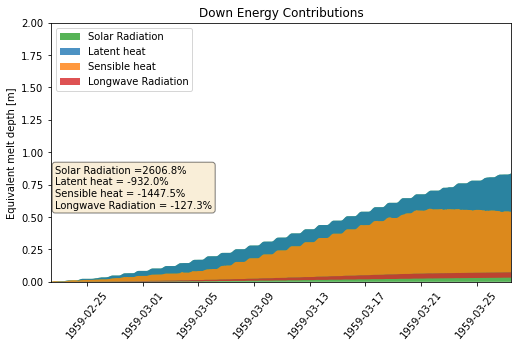

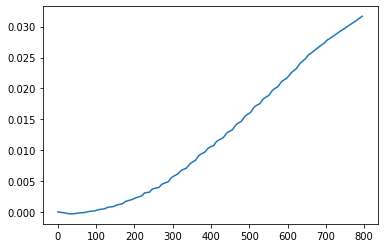

<Figure size 432x288 with 0 Axes>

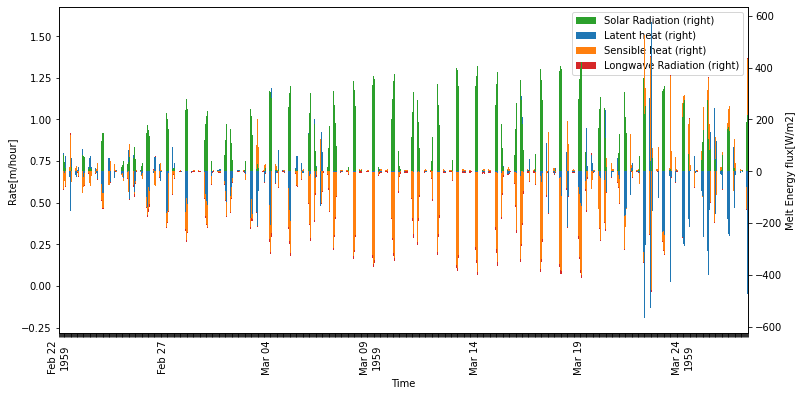

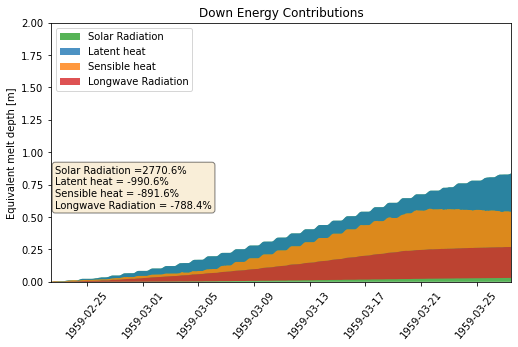

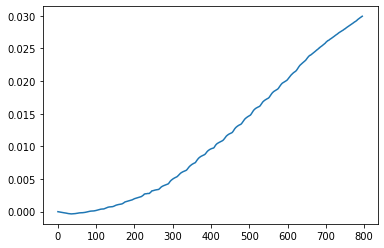

<Figure size 432x288 with 0 Axes>

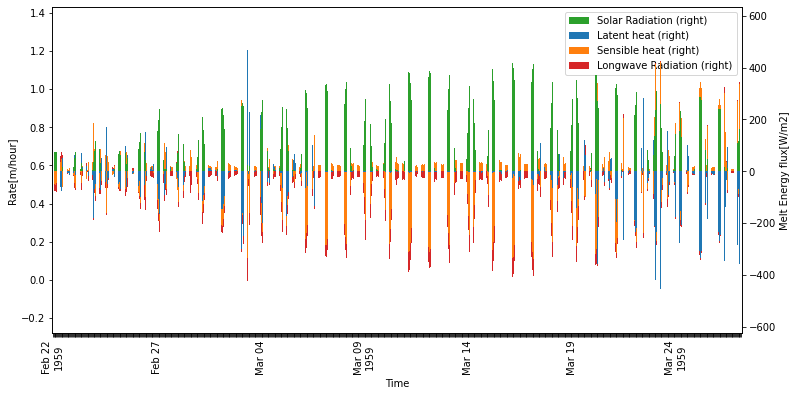

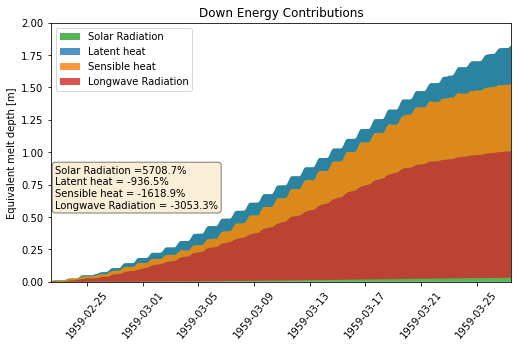

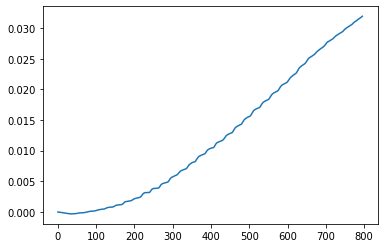

<Figure size 432x288 with 0 Axes>

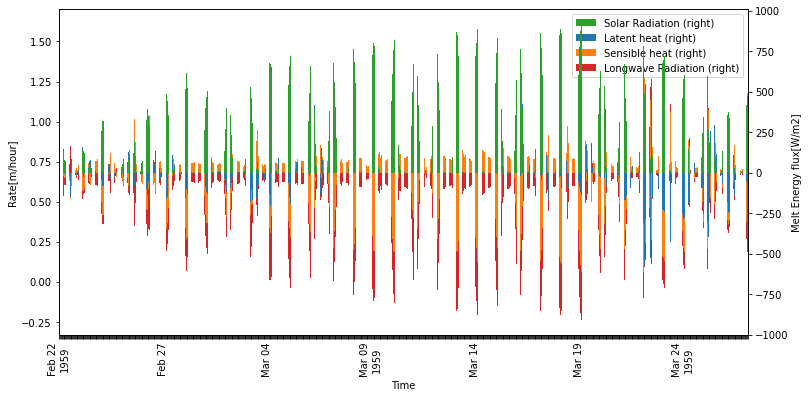

In [238]:
melt_plot(df_s2_1,y_lim=[0,2])
melt_plot(df_s3_1,y_lim=[0,2])
melt_plot(df_s4_1,y_lim=[0,2])

### 2.2 glasswool vs sawdust (1959,box_al) df_s3_1 df_s4_1

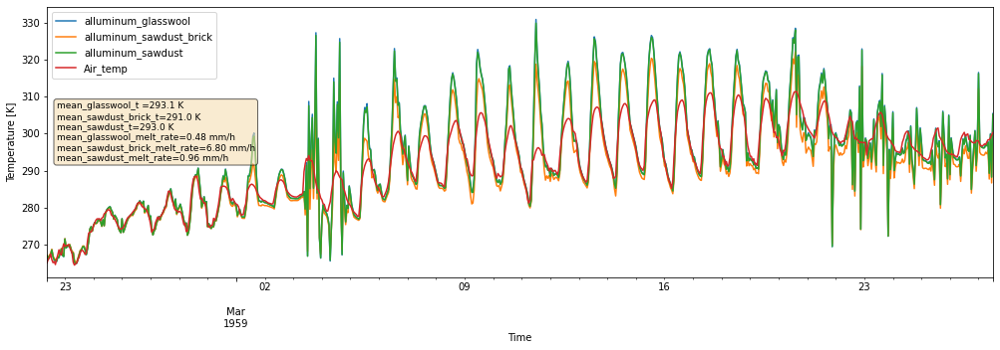

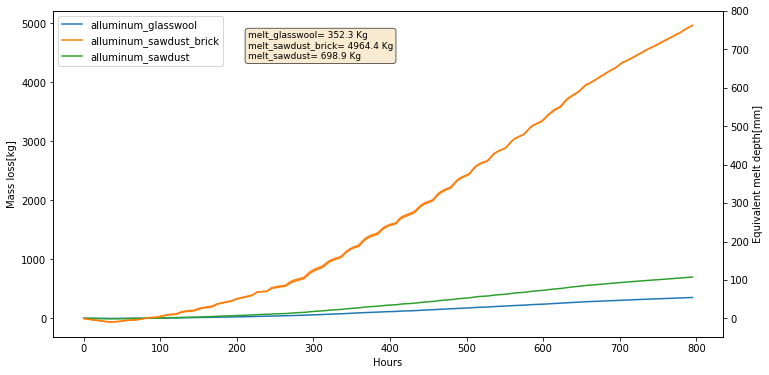

In [251]:
compare_plot([df_s3_1,df_s5_1,df_s6_1],['alluminum_glasswool','alluminum_sawdust_brick','alluminum_sawdust'])

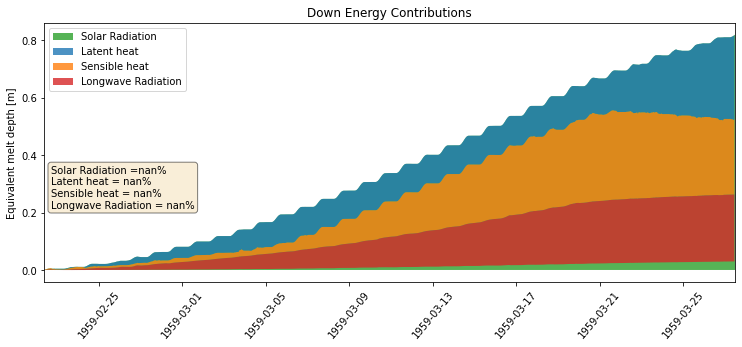

<Figure size 432x288 with 0 Axes>

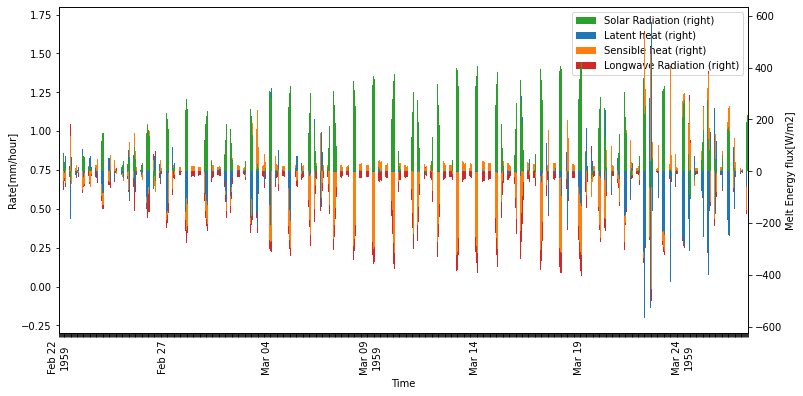

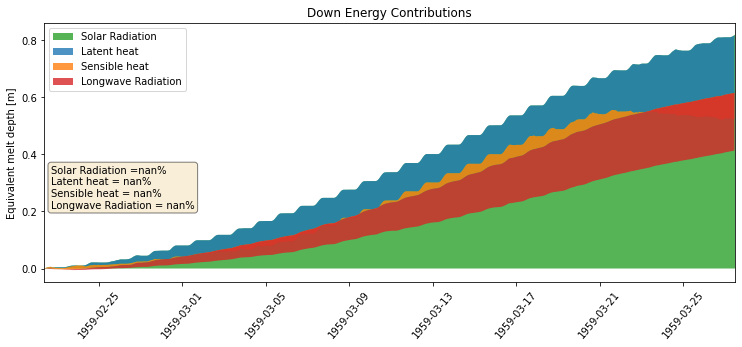

<Figure size 432x288 with 0 Axes>

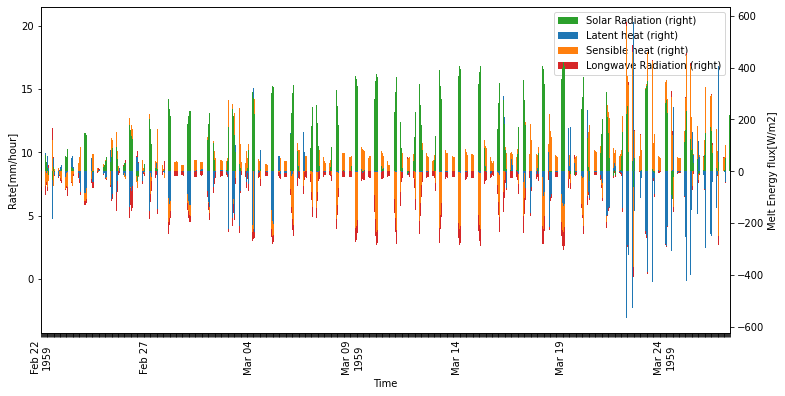

In [392]:
melt_plot(df_s3_1)
melt_plot(df_s4_1)

### 2.3 1959 vs 2020 (1959,box_al)

In [272]:
147+69

216

In [ ]:
df_s3_1[].iloc[215]

In [275]:
print('1959',df_s3_1['ice_melt_mass_hour'].cumsum().iloc[215])
print('2021',df_s3_3['ice_melt_mass_hour'].cumsum().iloc[215])
print('2020',df_s3_2['ice_melt_mass_hour'].cumsum().iloc[215])

1959 26.542672895570988
2021 31.99878136206332
2020 22.996745138709755


In [276]:
print('1959',(df_s3_1['ice_melt_mass_hour'].cumsum().iloc[500]-df_s3_1['ice_melt_mass_hour'].cumsum().iloc[400])/100*24)
print('2021',(df_s3_3['ice_melt_mass_hour'].cumsum().iloc[500]-df_s3_3['ice_melt_mass_hour'].cumsum().iloc[400])/100*24)
print('2020',(df_s3_2['ice_melt_mass_hour'].cumsum().iloc[500]-df_s3_2['ice_melt_mass_hour'].cumsum().iloc[400])/100*24)

1959 14.27519244949195
2021 13.24210506055024
2020 11.728638630945504


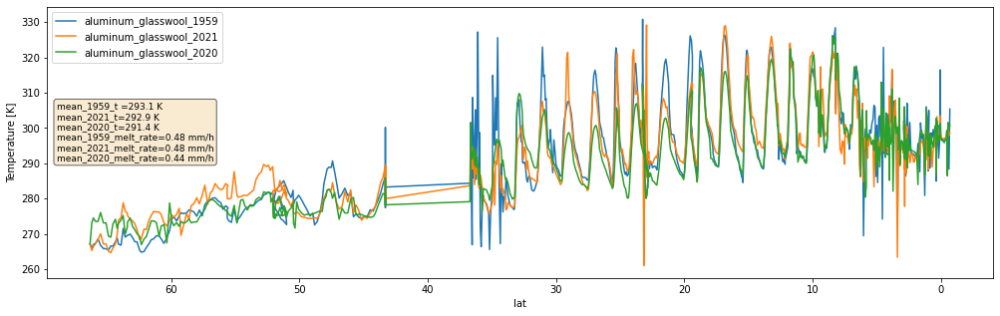

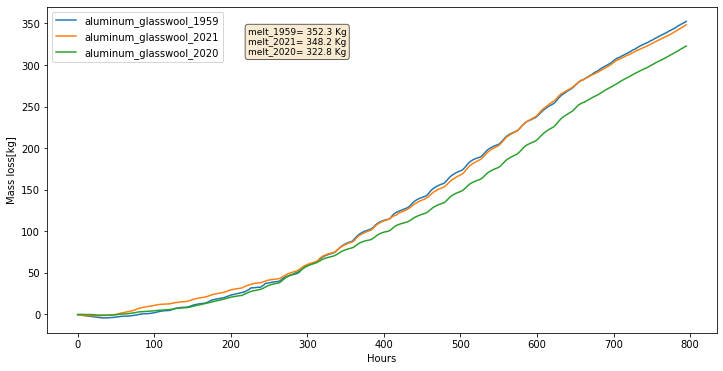

In [269]:
compare_plot([df_s3_1,df_s3_3,df_s3_2],['aluminum_glasswool_1959','aluminum_glasswool_2021','aluminum_glasswool_2020'])

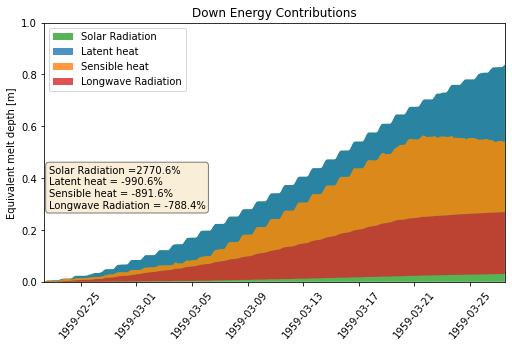

<Figure size 432x288 with 0 Axes>

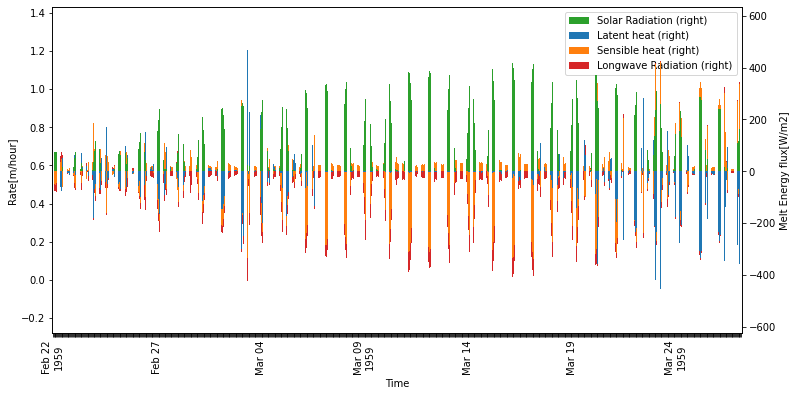

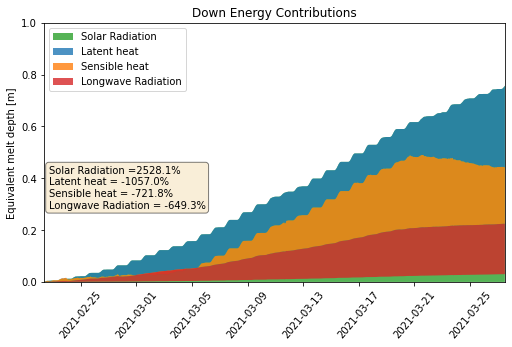

<Figure size 432x288 with 0 Axes>

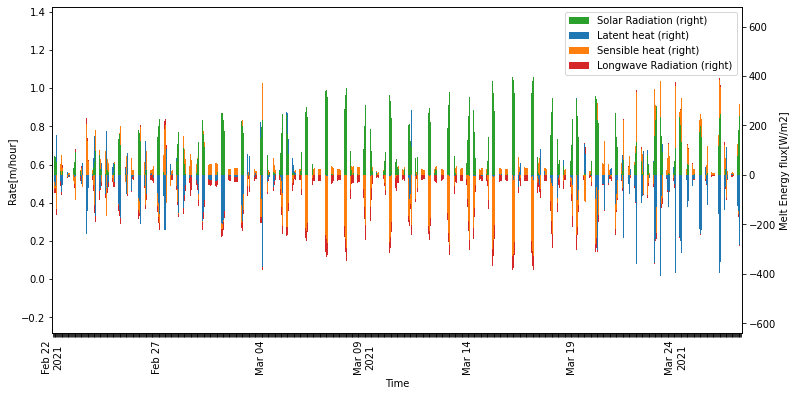

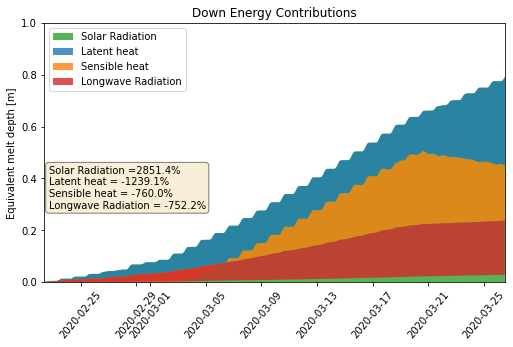

<Figure size 432x288 with 0 Axes>

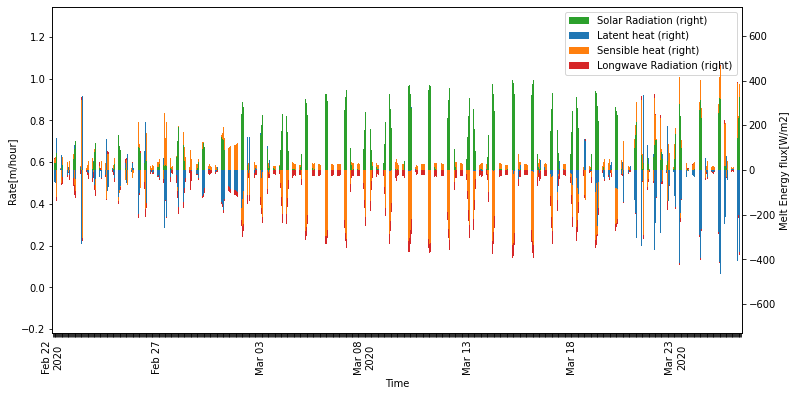

In [281]:
melt_plot(df_s3_1,y_lim=[0,1])
melt_plot(df_s3_3,y_lim=[0,1])
melt_plot(df_s3_2,y_lim=[0,1])

<AxesSubplot:>

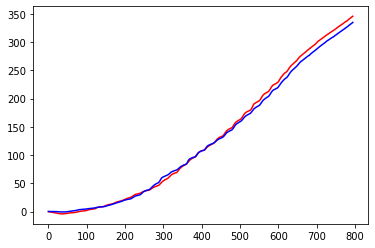

In [397]:
df_s3_1['ice_melt_mass_hour'].cumsum().plot(color='r')
df_s3_2['ice_melt_mass_hour'].cumsum().plot(color='b')

## ~STEP 3: 3D Heat equation~

In [ ]:
np.savetxt('1959_box_temp.csv',box_t)

In [10]:
box_t = np.genfromtxt ('1959_box_temp.csv')

In [12]:
box_t

array([-6.        , -7.17171242, -6.16593504, -5.78015042, -4.56604311,
       -6.37283407, -7.27886767, -7.34352774, -7.6841193 , -6.56412809,
       -6.6221925 , -5.41641879, -4.34188875, -6.03446079, -6.34341758,
       -1.59585866, -4.04322651, -3.61635239, -3.54394752, -3.19145192,
       -4.22577077, -5.37916471, -5.40777379, -7.79602849, -8.34144911,
       -8.10717147, -7.02701736, -5.89241112, -4.80225067, -4.53390199,
       -3.68777482, -3.6562699 , -4.55158907, -5.82632206, -4.2070264 ,
       -2.15617333,  1.07827987,  1.71593403,  0.5216349 ,  1.99041199,
        2.82253256,  2.6221804 ,  2.7857478 ,  3.67757626,  3.39620442,
        3.09938239,  1.8652287 ,  3.60363409,  1.9663881 ,  5.11688411,
        6.18632062,  6.59817209,  6.95662573,  7.10186498,  6.2335241 ,
        5.651761  ,  3.82626036,  4.82084068,  4.25945902,  3.62375525,
        1.38281898,  0.60503352,  0.11355818,  3.88079276,  0.21442757,
        0.93391458,  1.99918798,  3.05867785,  3.84553093,  4.37

In [11]:
#box_t = df_s3_1['box_t']-273.15

NameError: name 'df_s3_1' is not defined

In [13]:
np.array(box_t)[795]

32.234171878144195

In [9]:
from numba import jit
import numpy as np

dt = 60 # seconds
a_ice = 1.19e-6
a_air = 18.46e-6 # m2/s 
a_gw = 1.785e-6
dx=0.01 # m
hours = 100 # hours

In [12]:
# 1 initial dimension
ice_width =149 #cm
box_thickness = 2 # cm
gl_thickness = 25 # cm
nx = ny = nz = ice_width+box_thickness+gl_thickness

# 2 initial temp
heatmap = np.zeros([nx,ny,nz])-6 # inital temp -6
# 3 initial musk   3:box  2:glasswool 1:ice 0:air
block = np.ones([nx,ny,nz])   # 1:ice
    # glasswool
block[[np.arange(0,gl_thickness+box_thickness),np.arange(-gl_thickness-box_thickness,0)],:,:] = 2
block[:,[np.arange(0,gl_thickness+box_thickness),np.arange(-gl_thickness-box_thickness,0)],:] = 2
block[:,:,[np.arange(0,gl_thickness+box_thickness),np.arange(-gl_thickness-box_thickness,0)]] = 2
    # box
block[[np.arange(0,box_thickness),np.arange(-box_thickness,0)],:,:] = 3
block[:,[np.arange(0,box_thickness),np.arange(-box_thickness,0)],:] = 3
block[:,:,[np.arange(0,box_thickness),np.arange(-box_thickness,0)]] = 3

In [1]:
@jit(nopython=True, nogil=True)
def interation(cs,ns,block):
    lz,ly,lx = ns.shape
    for i in range(0,lx):
        for j in range(0,ly):
            for k in range(0,lz):
                if block[k][j][i] == 2: #glasswool
                    ns[k][j][i] = cs[k][j][i] + a_gw*dt/dx**2 * (cs[k][j+1][i] + cs[k][j-1][i] +
                                                                       cs[k+1][j][i]+cs[k-1][j][i]+
                                                                       cs[k][j][i+1]+cs[k][j][i-1]-
                                                                       6*cs[k][j][i])
                elif block[k][j][i] == 0: #air
                    ns[k][j][i] = cs[k][j][i] + a_air*dt/dx**2 * (cs[k][j+1][i] + cs[k][j-1][i] +
                                                                       cs[k+1][j][i]+cs[k-1][j][i]+
                                                                       cs[k][j][i+1]+cs[k][j][i-1]-
                                                                       6*cs[k][j][i])
                elif block[k][j][i] == 1: #ice
                    ns[k][j][i] = cs[k][j][i] + a_ice*dt/dx**2 * (cs[k][j+1][i] + cs[k][j-1][i] +
                                                                       cs[k+1][j][i]+cs[k-1][j][i]+
                                                                       cs[k][j][i+1]+cs[k][j][i-1]-
                                                                       6*cs[k][j][i])
                else: #pass boundry conditon
                    pass
    return ns

def solve_heat(heatmap,block,box_temp_list):
    hm_list = []
    cs = heatmap.copy() # initial temp state
    box_musk = block == 3
    for h in range(0,hours):
        cs[box_musk] = box_temp_list[h] # assign box temp
        ns = cs.copy() # new state
        for t in range(1,61): # iteration in minutes
            cs = interation(cs,ns,block).copy()
            # update a: if ice > 0 degree turn into air
            ice_mask = block == 1
            temp_mask = ns > 0
            block[ice_mask & temp_mask] = 0
            
        if h%1 ==0: # return every hour
            hm_list.append(cs)
            print('Now: in hour',len(hm_list))
    return hm_list


NameError: name 'jit' is not defined

In [28]:
hm_list = solve_heat(heatmap,block,np.array(box_t))

Now: in hour 1
Now: in hour 2
Now: in hour 3
Now: in hour 4
Now: in hour 5
Now: in hour 6
Now: in hour 7
Now: in hour 8
Now: in hour 9
Now: in hour 10
Now: in hour 11
Now: in hour 12
Now: in hour 13
Now: in hour 14
Now: in hour 15
Now: in hour 16
Now: in hour 17
Now: in hour 18
Now: in hour 19
Now: in hour 20
Now: in hour 21
Now: in hour 22
Now: in hour 23
Now: in hour 24
Now: in hour 25
Now: in hour 26
Now: in hour 27
Now: in hour 28
Now: in hour 29
Now: in hour 30
Now: in hour 31
Now: in hour 32
Now: in hour 33
Now: in hour 34
Now: in hour 35
Now: in hour 36
Now: in hour 37
Now: in hour 38
Now: in hour 39
Now: in hour 40
Now: in hour 41
Now: in hour 42
Now: in hour 43
Now: in hour 44
Now: in hour 45
Now: in hour 46
Now: in hour 47
Now: in hour 48
Now: in hour 49
Now: in hour 50
Now: in hour 51
Now: in hour 52
Now: in hour 53
Now: in hour 54
Now: in hour 55
Now: in hour 56
Now: in hour 57
Now: in hour 58
Now: in hour 59
Now: in hour 60
Now: in hour 61
Now: in hour 62
Now: in hour 63
N

array([[3., 3., 3., ..., 3., 3., 3.],
       [3., 3., 3., ..., 3., 3., 3.],
       [3., 3., 2., ..., 2., 3., 3.],
       ...,
       [3., 3., 2., ..., 2., 3., 3.],
       [3., 3., 3., ..., 3., 3., 3.],
       [3., 3., 3., ..., 3., 3., 3.]])

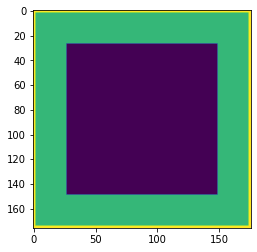

In [18]:
plt.imshow(block[27,:,:])
block[27,:,:]

In [32]:
x_t

[-6.0,
 4.950416079563394e+57,
 6.146542850495467e+120,
 7.933336515234599e+200,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan]

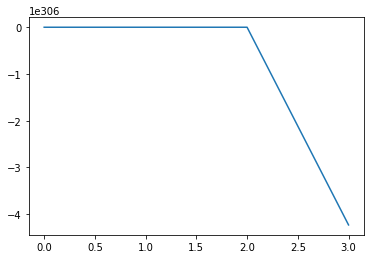

In [44]:
x_t = [hm_list[i][43,44,66] for i in range(100)]
plt.plot(x_t)

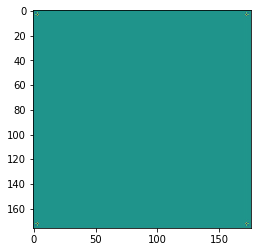

In [62]:
ax = plt.imshow(hm_list[12][3,8,3])

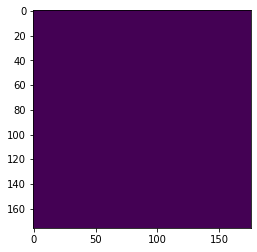

In [28]:
import matplotlib.animation as animation

fig, ax = plt.subplots()
ims = []
for i in range(100):
    im = ax.imshow(hm_list[i][:,1,:], animated=True)
    if i == 0:
        ax.imshow(hm_list[i][:,1,:])  # show an initial one first
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)

In [29]:
from IPython.display import HTML
HTML(ani.to_jshtml())

In [82]:
block[0:30,3,0:30]

array([[3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
        3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.],
       [3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
        3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.],
       [3., 3., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
        2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.],
       [3., 3., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
        2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.],
       [3., 3., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
        2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.],
       [3., 3., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
        2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.],
       [3., 3., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
        2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.],
       [3., 3., 2., 2., 2., 2., 2., 2., 2

In [480]:
for i in range(1,2):
    print(i)

1


In [135]:
nx/2

88.0

In [368]:
gl_thickness = 2
frame[[np.arange(0,gl_thickness+1),np.arange(-gl_thickness-1,0)],:,:]

array([[[[1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.]],

        [[1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.]],

        [[1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
         [1., 0., 0., 0., 0., 0., 0., 1.],
       

In [367]:
np.arange(0,gl_thickness+1),np.arange(-gl_thickness-1,0)

(array([0, 1, 2]), array([-3, -2, -1]))

In [390]:
a = frame_a==0

In [391]:
frame_a

array([[[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.]],

       [[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.]],

       [[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 0.]]])

In [393]:
frame

array([[[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]]])

In [394]:
frame[a] = 2

In [395]:
frame

array([[[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 2.]]])

In [295]:
a = np.array([[1,2,3,4],[1,2,3,4],[2,3,4,5]])

In [296]:
a.shape

(3, 4)

## 2D heat equation

In [2]:
box_t = np.loadtxt('1959_box_temp.csv')

In [114]:
len(box_t)

796

In [524]:
from numba import jit
import numpy as np
from scipy.ndimage import binary_dilation, binary_erosion

# 1 environment
box_t = np.loadtxt('1959_box_temp.csv')

# 2 settings
a_ice = 1.19e-6 # heat difussivity [m2/s]
a_air = 18.46e-6 # heat difussivity [m2/s]
a_gw = 1.785e-6 # heat difussivity [m2/s]

lf = 334000 #Latent heat of fusion L f = 334 000 J/kg -1 (phase change ice – water)
cp_ice = 2108 # J/(kgK)
rho_ice = 917 # Kg/m3

t_ice = -6 # initial temperature of ice
dx=0.01 # 1cm nodes
dt = 1 # seconds
hours = len(box_t) # hours here is 796

In [525]:
# 3 initial 
heatmap = np.zeros([ice_width,ice_width])+t_ice # inital temp
block = np.ones([ice_width,ice_width])   # initial musk   1:ice 0:air
tt = lf*rho_ice*0.01*0.01*0.01/(cp_ice*rho_ice*0.01*0.01*0.01)-t_ice  # energy musk: the energy required to melt in [K]
energy = block*tt

block[[0,-1],:]=0 # air boundary
block[:,[0,-1]]=0

energy[[0,-1],:]=0 # air boundary
energy[:,[0,-1]]=0

In [508]:
import copy

@jit(nopython=True, nogil=True)
def iteration(cs,inner_musk,energy,outer_musk,box_t):
    ns = cs.copy() # new state
    ns_energy = energy.copy() # new state
    ly,lx = ns.shape
    for i in range(0,lx):
        for j in range(0,ly):
            if outer_musk[j][i] == 1: #outer node
                #heat flux -> warm-up 
                #q = (box_t-cs[j][i])/0.25*0.04   # W/m2
                #dT = q/(917*0.01)/2108
                ns[j][i] = cs[j][i] +  (box_t-cs[j][i])/0.25*0.04/(917*0.01)/2108*dt
                ns_energy[j][i] = energy[j][i] - (box_t-cs[j][i])/0.25*0.04/(917*0.01)/2108*dt
                #ns_energy[j][i] = energy[j][i] - 30/3600*dt

                # ->add energy storage -> latent heat flux
                if ns[j][i]>0:
                    ns[j][i] = 0

            if inner_musk[j][i] == 1: #inner node
                ns[j][i] = cs[j][i] + a_ice*dt/dx**2 * (cs[j+1][i] + cs[j-1][i] +
                                                        cs[j][i+1]+cs[j][i-1]-
                                                        4*cs[j][i])
            else: #pass boundry conditon
                pass
    return ns,ns_energy
def find_outer_musk(a):
    a= a.astype(int)
    k = np.ones((3,3),dtype=int) # for 4-connected
    #k = np.zeros((3,3),dtype=int); k[1] = 1; k[:,1] = 1 # for 8-connected
    out = binary_dilation(a==0, k) & a
    inside = binary_erosion(a).astype(a.dtype)
    return out,inside

def solve_heat(heatmap,block,box_temp_list,energy):
    hm_list = []
    block_list = []
    energy_list = []
    inner_musk_list = []
    cs = heatmap.copy() # initial temp state
    energy_musk = energy.copy()
    block_musk = block.copy()

    for h in range(0,hours):     
        
        for t in range(1,3600): # iteration in seconds
            # HEAT diffusion
            outer_musk,inner_musk = find_outer_musk(block_musk)
            cs,energy_musk = iteration(cs,inner_musk,energy_musk,outer_musk,box_temp_list[h]) #update cs and energy_musk
            block_musk[energy_musk <0] = 0 # update blockmusk: TURN INTO AIR
        if h%1 ==0: # return every hour
            hm_list.append(cs)
            block_list.append(block_musk.copy())
            energy_list.append(energy_musk)
            inner_musk_list.append(inner_musk)
            print('Now: in hour',len(hm_list))
    return hm_list,block_list,energy_list,inner_musk_list


#### Test musk

In [443]:
outer_musk,inner_musk = find_outer_musk(block)


In [215]:
energy[1,1] = -1
energy

array([[306.278, 306.278, 306.278, ..., 306.278, 306.278, 306.278],
       [306.278,  -1.   , 306.278, ..., 306.278, 306.278, 306.278],
       [306.278, 306.278, 306.278, ..., 306.278, 306.278, 306.278],
       ...,
       [306.278, 306.278, 306.278, ..., 306.278, 306.278, 306.278],
       [306.278, 306.278, 306.278, ..., 306.278, 306.278, 306.278],
       [306.278, 306.278, 306.278, ..., 306.278, 306.278, 306.278]])

In [450]:
#block[energy <0]= 0
block

array([[0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 1., 1., 1., 1., 1., 1., 1., 0.],
       [0., 1., 1., 1., 1., 1., 1., 1., 0.],
       [0., 1., 1., 1., 1., 1., 1., 1., 0.],
       [0., 1., 1., 1., 1., 1., 1., 1., 0.],
       [0., 1., 1., 1., 1., 1., 1., 1., 0.],
       [0., 1., 1., 1., 1., 1., 1., 1., 0.],
       [0., 1., 1., 1., 1., 1., 1., 1., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.]])

In [476]:
inner_musk_2d[12]

array([[0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 1, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0]])

In [ ]:
block_2d[5]

In [477]:
energy_2d[12]

array([[ 1.59444023e+02,  1.59444023e+02,  1.59444023e+02,
         1.59444023e+02,  1.59444023e+02,  1.59444023e+02,
         1.59444023e+02,  1.59444023e+02,  1.59444023e+02],
       [ 1.59444023e+02, -5.97722962e-03, -5.97722962e-03,
        -5.97722962e-03, -5.97722962e-03, -5.97722962e-03,
        -5.97722962e-03, -5.97722962e-03,  1.59444023e+02],
       [ 1.59444023e+02, -5.97722962e-03, -5.97722962e-03,
        -5.97722962e-03, -5.97722962e-03, -5.97722962e-03,
        -5.97722962e-03, -5.97722962e-03,  1.59444023e+02],
       [ 1.59444023e+02, -5.97722962e-03, -5.97722962e-03,
         8.84523561e+01,  8.84523561e+01,  8.84523561e+01,
        -5.97722962e-03, -5.97722962e-03,  1.59444023e+02],
       [ 1.59444023e+02, -5.97722962e-03, -5.97722962e-03,
         8.84523561e+01,  1.59444023e+02,  8.84523561e+01,
        -5.97722962e-03, -5.97722962e-03,  1.59444023e+02],
       [ 1.59444023e+02, -5.97722962e-03, -5.97722962e-03,
         8.84523561e+01,  8.84523561e+01,  8.845235

In [421]:
block_2d[0]

array([[0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 1., 1., 1., 1., 1., 0., 0.],
       [0., 0., 1., 1., 1., 1., 1., 0., 0.],
       [0., 0., 1., 1., 1., 1., 1., 0., 0.],
       [0., 0., 1., 1., 1., 1., 1., 0., 0.],
       [0., 0., 1., 1., 1., 1., 1., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.]])

In [422]:
block_2d[-1]

array([[0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 1., 1., 1., 1., 1., 0., 0.],
       [0., 0., 1., 1., 1., 1., 1., 0., 0.],
       [0., 0., 1., 1., 1., 1., 1., 0., 0.],
       [0., 0., 1., 1., 1., 1., 1., 0., 0.],
       [0., 0., 1., 1., 1., 1., 1., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0.]])

In [420]:
inner_musk_2d[-1]

array([[0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 1, 1, 1, 0, 0, 0],
       [0, 0, 0, 1, 1, 1, 0, 0, 0],
       [0, 0, 0, 1, 1, 1, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0]])

In [29]:
a = np.array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 1, 1, 0, 0, 0, 0],
       [0, 0, 0, 1, 1, 1, 0, 0, 0, 0],
       [0, 0, 1, 1, 1, 1, 0, 0, 0, 0],
       [0, 0, 1, 1, 1, 1, 0, 0, 0, 0],
       [0, 1, 1, 1, 1, 1, 0, 0, 0, 0],
       [0, 0, 1, 1, 1, 1, 0, 0, 0, 0],
       [0, 1, 1, 1, 1, 1, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]])


In [87]:
a= np.ones([6,6]).astype(int)

In [88]:
a

array([[1, 1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1, 1]])

In [57]:
block= block.astype(int)

In [44]:
block

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 1, 1, ..., 1, 1, 0],
       [0, 1, 1, ..., 1, 1, 0],
       ...,
       [0, 1, 1, ..., 1, 1, 0],
       [0, 1, 1, ..., 1, 1, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [89]:
from scipy.ndimage import binary_dilation, binary_erosion
import numpy as np
k = np.ones((3,3),dtype=int) # for 4-connected
#k = np.zeros((3,3),dtype=int); k[1] = 1; k[:,1] = 1 # for 8-connected
out = binary_dilation(a==0, k) & a
inside = binary_erosion(a).astype(a.dtype)

In [90]:
out

array([[0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0]], dtype=int32)

In [91]:
inside

array([[0, 0, 0, 0, 0, 0],
       [0, 1, 1, 1, 1, 0],
       [0, 1, 1, 1, 1, 0],
       [0, 1, 1, 1, 1, 0],
       [0, 1, 1, 1, 1, 0],
       [0, 0, 0, 0, 0, 0]])

### test run

In [527]:
hm_list_2d,block_2d,energy_2d,inner_musk_2d = solve_heat(heatmap,block,box_t,energy)

Now: in hour 1
Now: in hour 2
Now: in hour 3
Now: in hour 4
Now: in hour 5
Now: in hour 6
Now: in hour 7
Now: in hour 8
Now: in hour 9
Now: in hour 10
Now: in hour 11
Now: in hour 12
Now: in hour 13
Now: in hour 14
Now: in hour 15
Now: in hour 16
Now: in hour 17
Now: in hour 18
Now: in hour 19
Now: in hour 20
Now: in hour 21
Now: in hour 22
Now: in hour 23
Now: in hour 24
Now: in hour 25
Now: in hour 26
Now: in hour 27
Now: in hour 28
Now: in hour 29
Now: in hour 30
Now: in hour 31
Now: in hour 32
Now: in hour 33
Now: in hour 34
Now: in hour 35
Now: in hour 36
Now: in hour 37
Now: in hour 38
Now: in hour 39
Now: in hour 40
Now: in hour 41
Now: in hour 42
Now: in hour 43
Now: in hour 44
Now: in hour 45
Now: in hour 46
Now: in hour 47
Now: in hour 48
Now: in hour 49
Now: in hour 50
Now: in hour 51
Now: in hour 52
Now: in hour 53
Now: in hour 54
Now: in hour 55
Now: in hour 56
Now: in hour 57
Now: in hour 58
Now: in hour 59
Now: in hour 60
Now: in hour 61
Now: in hour 62
Now: in hour 63
N

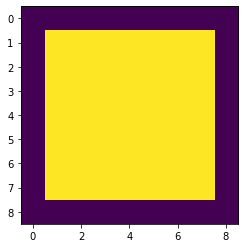

In [500]:
ax = plt.imshow(block_2d[0])

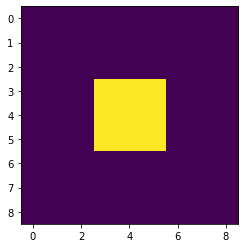

In [501]:
ax = plt.imshow(inner_musk_2d[-1])

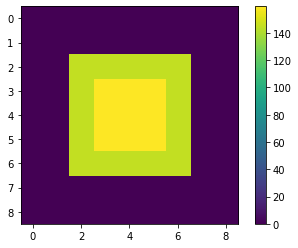

In [502]:
ax = plt.imshow(energy_2d[-1])
ar = plt.colorbar(ax)

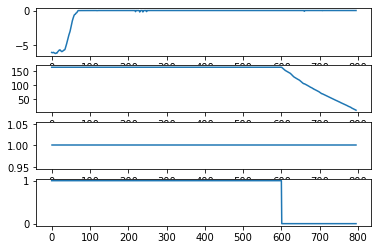

In [543]:
x = 3
e_t = [energy_2d[i][x,x] for i in range(hours)]
x_t = [hm_list_2d[i][x,x] for i in range(hours)]
h_t = [block_2d[i][x,x] for i in range(hours)]
z_t = [inner_musk_2d[i][x,x] for i in range(hours)]

fig,(ax,ax2,ax3,ax4) = plt.subplots(4)
ax.plot(x_t) # temp
ax2.plot(e_t) # energy
ax3.plot(h_t) # block
ax4.plot(z_t) # inner
#ax.scatter(1,2)

In [544]:
e_t

[164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277039848,
 164.44402277

In [376]:
x_t

[-6.0,
 -6.018188484671959,
 -6.030365465428082,
 -6.029777714618398,
 -6.006094058981658,
 -5.999604578362127,
 -6.020172527477166,
 -6.051175820656063,
 -6.0896990001232805,
 -6.113979189870918,
 -6.130170245367611,
 -6.126267922523259,
 -6.095003265411341,
 -6.079131661424446,
 -6.079940967225263,
 -6.01141759605296,
 -5.942974094522871,
 -5.882333859237065,
 -5.819514711318328,
 -5.7515312432967995,
 -5.697818344587213,
 -5.671350881988932,
 -5.657416316527765,
 -5.68389960935819,
 -5.739970558358366,
 -5.800794700319995,
 -5.844603058348572,
 -5.8616549115025185,
 -5.850392475531675,
 -5.823441787066193,
 -5.778712294033893,
 -5.72550807693963,
 -5.684778077185556,
 -5.671309517053569,
 -5.644969547205416,
 -5.576216930579923,
 -5.439507647112421,
 -5.264117499893809,
 -5.098346837502283,
 -4.919568932767569,
 -4.719683600823165,
 -4.517769538879929,
 -4.317250672102272,
 -4.105610765990704,
 -3.8952471251750467,
 -3.69525585932672,
 -3.52178370871232,
 -3.336801735810085,
 -3.169

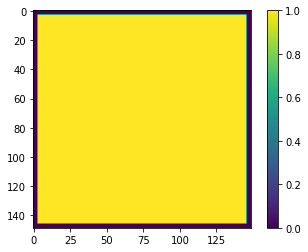

In [349]:
ax = plt.imshow(block_2d[660])
ar = plt.colorbar(ax)

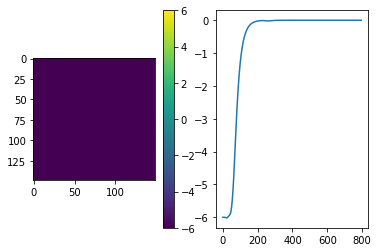

In [537]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation


x_t = [hm_list_2d[i][75,75] for i in range(hours)]



fig, (ax,ax2) = plt.subplots(1,2)
ims = []
ax2.plot(x_t)

for i in range(hours):
    txt=ax.text(10,-10,str(i+1)+' Hours')
    im = ax.imshow(hm_list_2d[i][:,:], animated=True,vmin=-6,vmax=6)
    im2 = ax2.scatter(i,x_t[i],vmin=-6,vmax=6)

    if i == 0:
        a = ax.imshow(hm_list_2d[i][:,:],vmin=-6,vmax=6)  # show an initial one first
    ims.append([im,im2,txt])
fig.colorbar(im,ax=ax)

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)

In [538]:
from IPython.display import HTML
HTML(ani.to_jshtml())

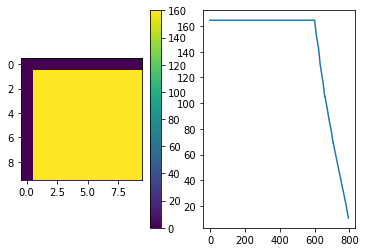

In [542]:
x_t = [energy_2d[i][3,3] for i in range(hours)]



fig, (ax,ax2) = plt.subplots(1,2)
ims = []
ax2.plot(x_t)

for i in range(hours):
    txt=ax.text(1,-1,str(i+1)+' Hours')
    im = ax.imshow(energy_2d[i][0:10,0:10], animated=True,vmin=0,vmax=160)
    im2 = ax2.scatter(i,x_t[i],vmin=-6,vmax=2)

    if i == 0:
        a = ax.imshow(energy_2d[i][0:10,0:10],vmin=0,vmax=160)  # show an initial one first
    ims.append([im,im2,txt])
fig.colorbar(im,ax=ax)

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)

In [540]:
from IPython.display import HTML
HTML(ani.to_jshtml())